In [1]:
import pickle
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
import math
from PIL import Image
from moviepy.editor import VideoFileClip

In [2]:
# options
# when debugged is set to True, debug info is printed and some cells not needed for the final video are executed  
#debug = True
debug = False

# when create_preview_video is True, the frames of the video are displayed on the notebook.
# it is also used for debug 
create_preview_video = False

In [3]:
# constants
window_width = 50
slices = 5

window_height =720//slices
margin = 70

kernelsize=3

In [4]:
# -----------------------------------------------------------
# calibrate the camera
# -----------------------------------------------------------

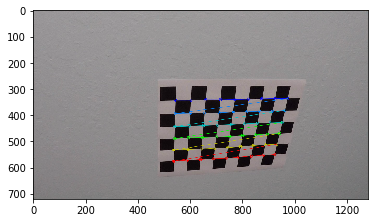

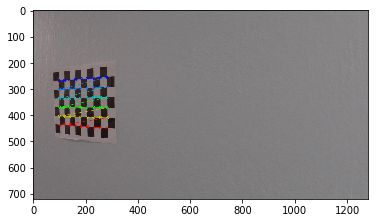

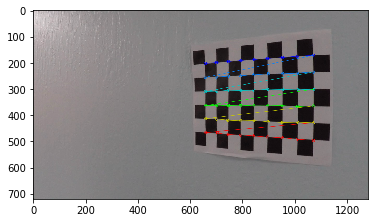

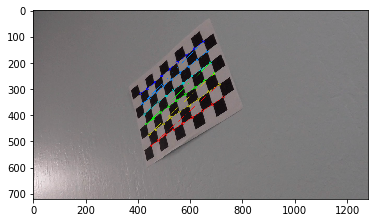

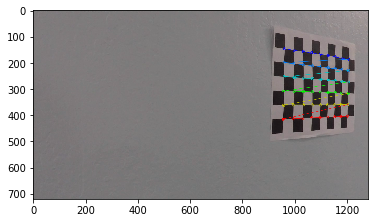

...

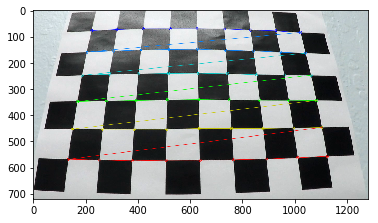

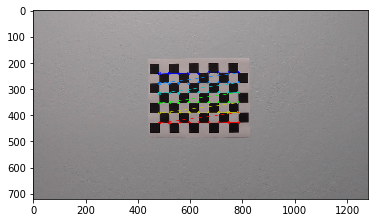

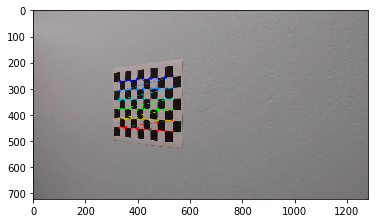

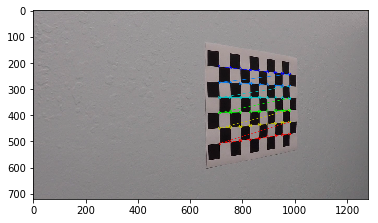

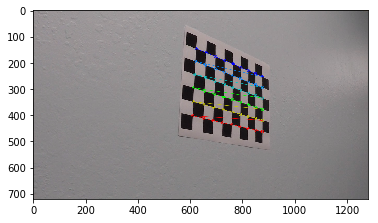

In [5]:

nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.
validFileNames =[]    # if the checkboard image is valid with 9 x 6 points the image is valid
# Make a list of calibration images
calibration_images = glob.glob('camera_cal/calibration*.jpg')

%matplotlib inline
# Step through the list and search for chessboard corners
for fname in calibration_images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
        validFileNames.append(fname)# in some images, not all of the corners are visible so an error will be raised if I try to undistort them. I create this list with the valid images.
        #Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        plt.imshow(img)
        plt.show()

In [6]:
# -----------------------------------------------------------
# Compute the camera calibration matrix and distortion 
# coefficients given a set of chessboard images.
# -----------------------------------------------------------

In [7]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints,imgpoints,gray.shape[::-1],None,None)

In [8]:
# -----------------------------------------------------------
# undistort images function
# -----------------------------------------------------------

In [9]:
def undistort(image):
    return cv2.undistort(image,mtx,dist,None,mtx) 

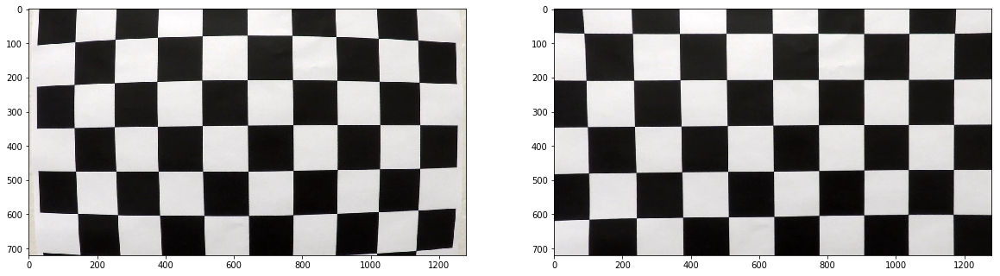

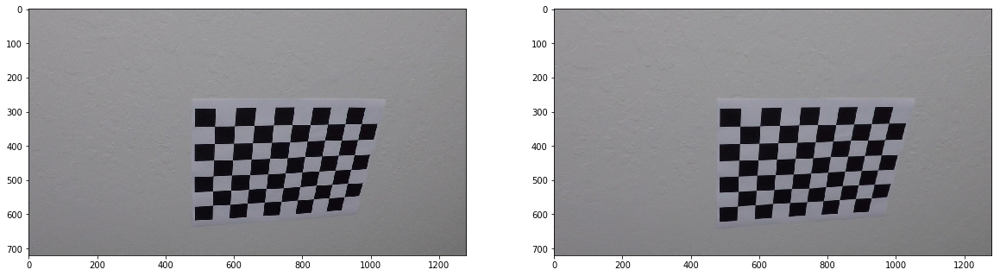

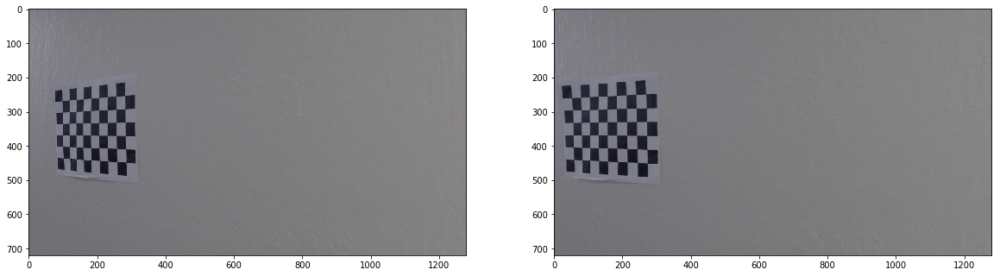

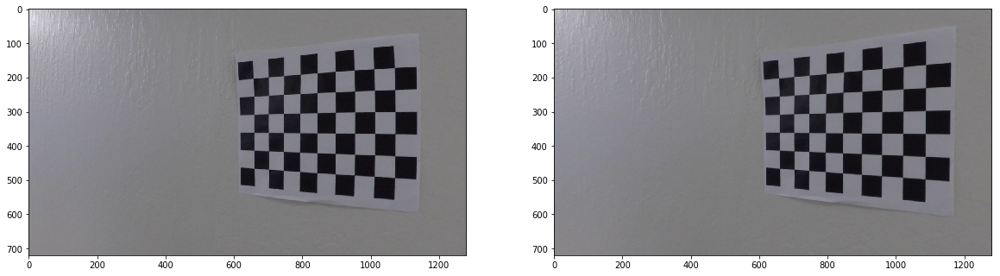

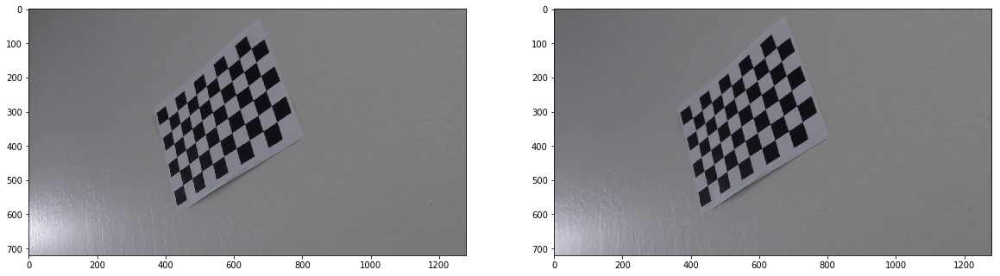

...

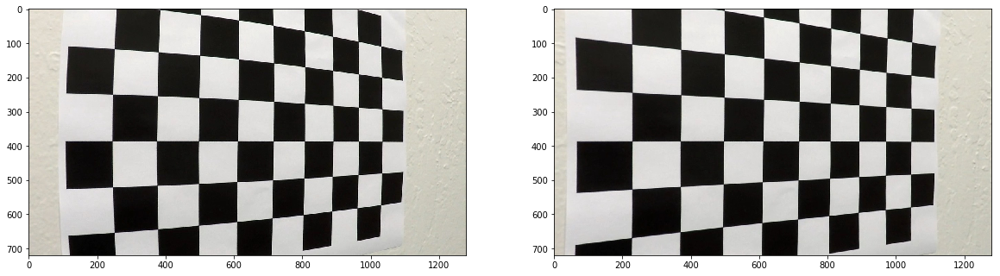

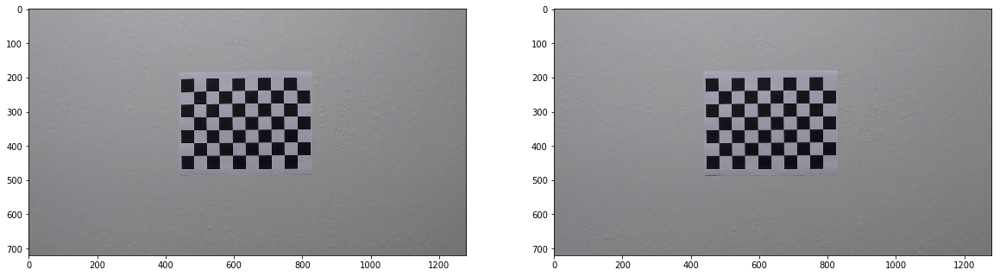

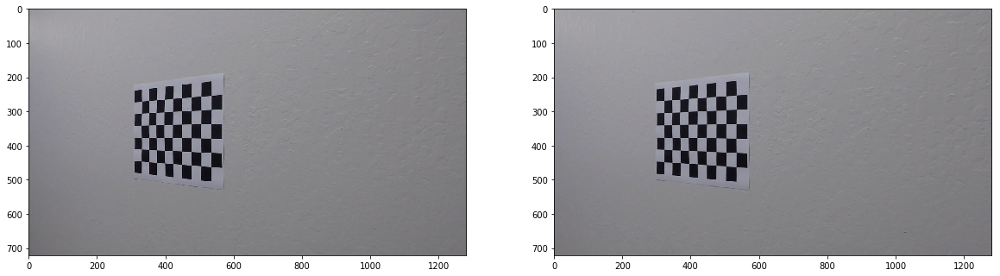

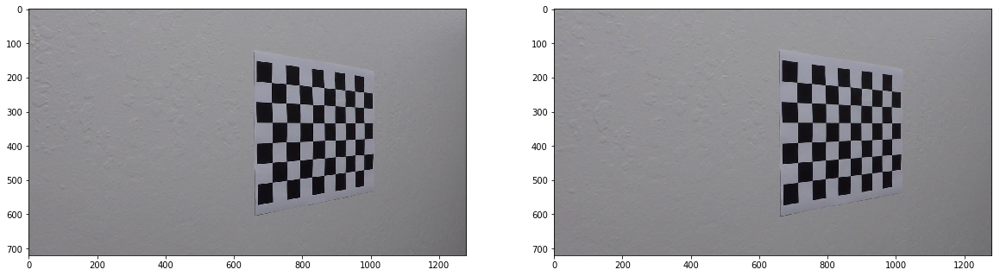

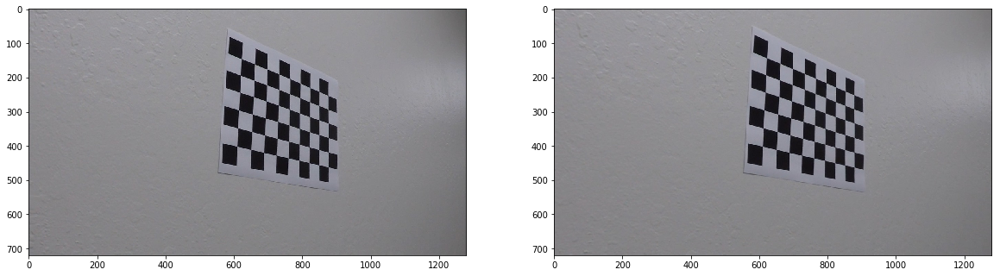

In [10]:
# display the undistorted callibration images
for fname in calibration_images:
    img = cv2.imread(fname)    
    fig = plt.figure(figsize=(20, 10))
    fig.add_subplot(1,2,1)
    plt.imshow(img[...,::-1])
    img = undistort(img)
    fig.add_subplot(1,2,2)
    plt.imshow(img[...,::-1])  # OpenCV to matplotlib color conversion (RGB <-> BGR): [...,::-1]
    plt.show(block=True)

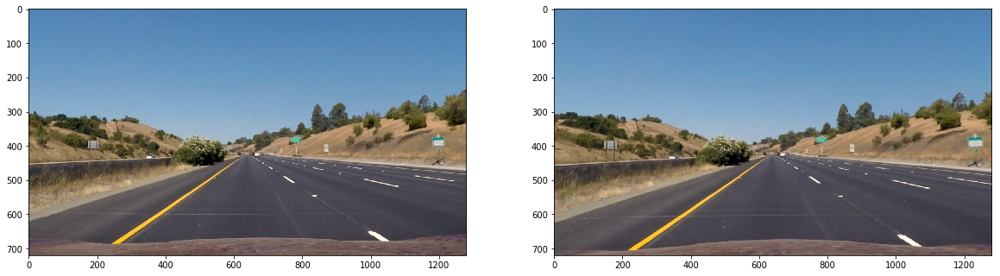

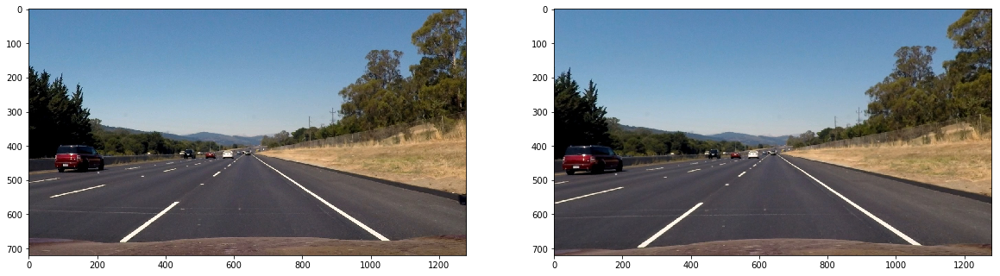

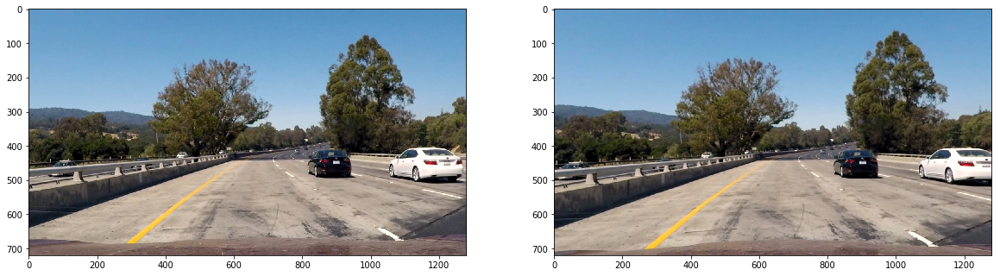

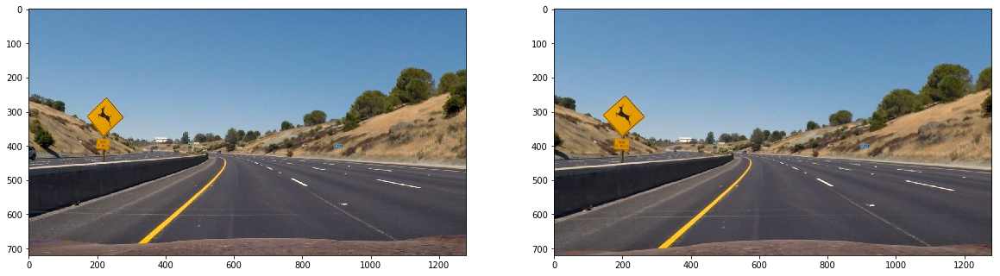

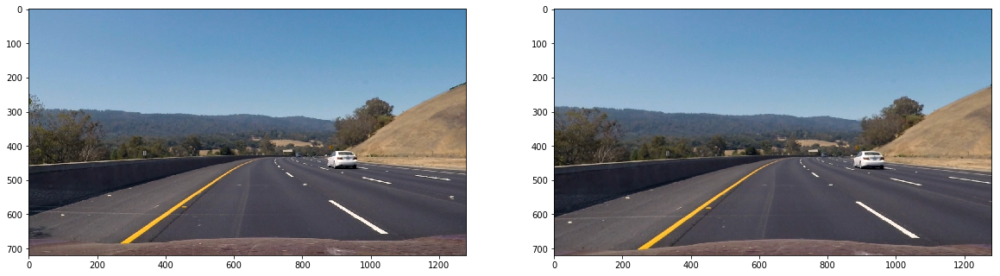

...

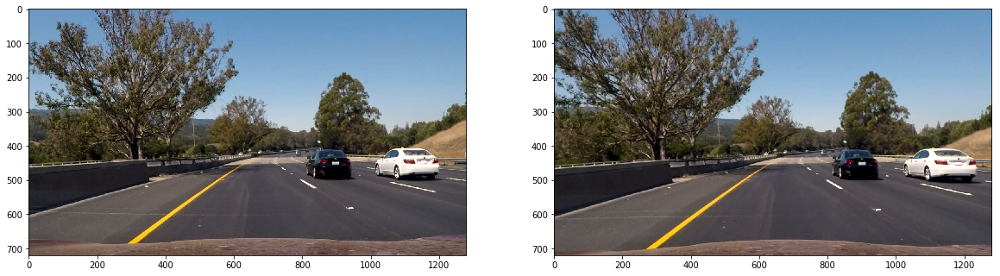

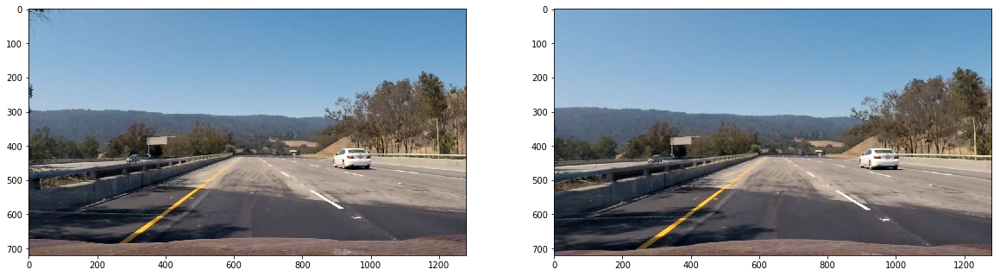

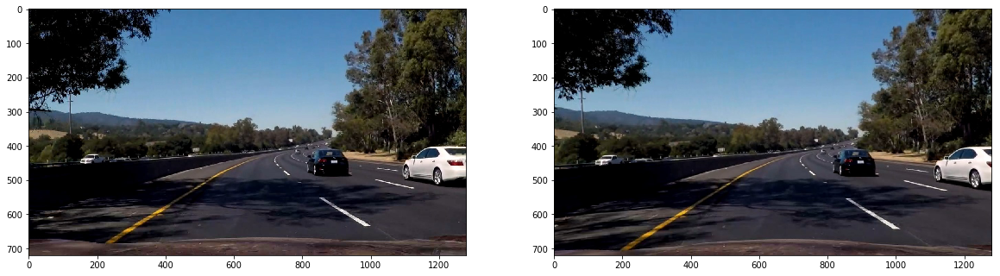

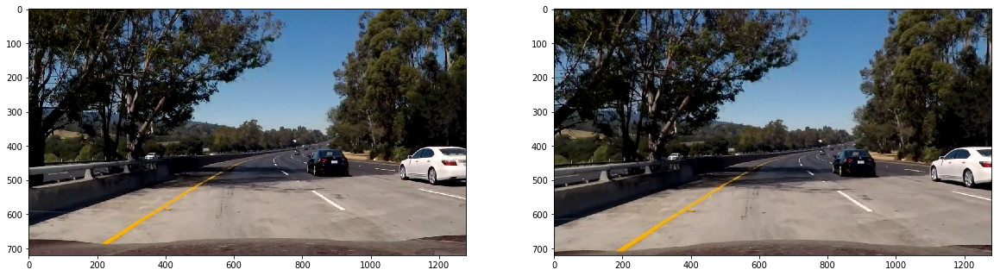

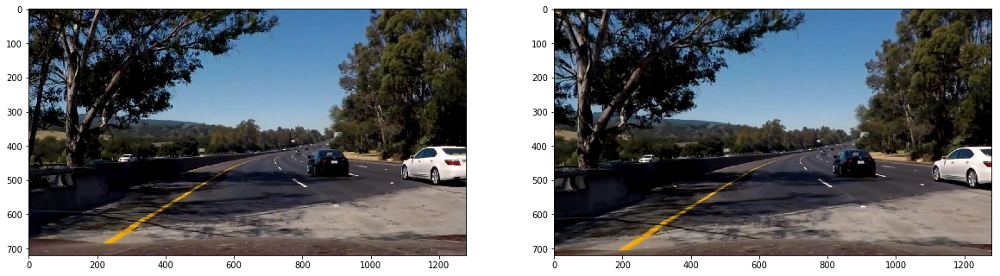

In [11]:
# display the undistorted images
images = glob.glob('test_images/*.jpg') # load the test images
for fname in images:
    img = cv2.imread(fname)    
    fig = plt.figure(figsize=(20, 10))
    fig.add_subplot(1,2,1)
    plt.imshow(img[...,::-1])
    img = undistort(img)
    fig.add_subplot(1,2,2)
    plt.imshow(img[...,::-1])  # OpenCV to matplotlib color conversion (RGB <-> BGR): [...,::-1]
    plt.show(block=True)

In [12]:
# -----------------------------------------------------------
# unwrap images
# -----------------------------------------------------------

In [13]:
def warper(img, src, dst):
    # Compute and apply perpective transform
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_CUBIC)  # keep same size as input image
    return warped

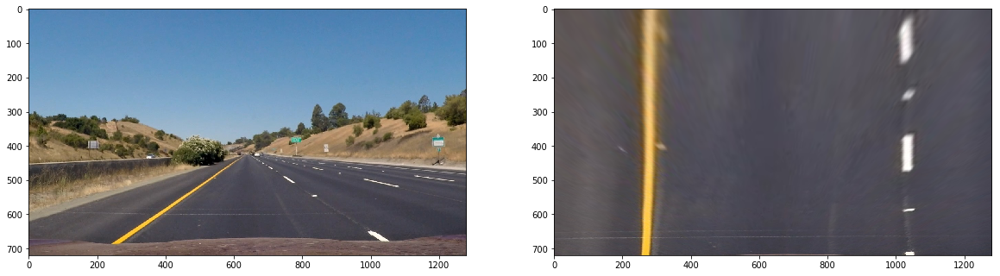

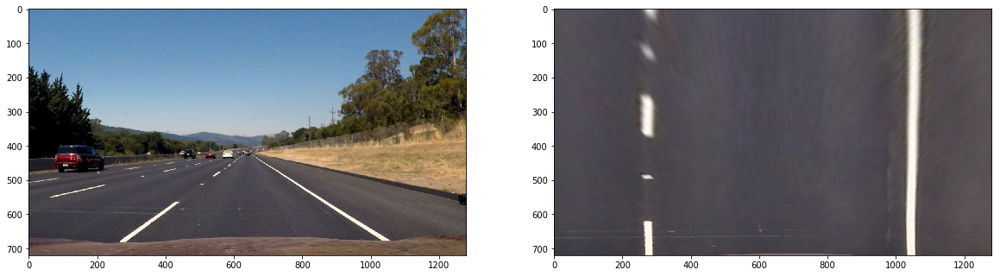

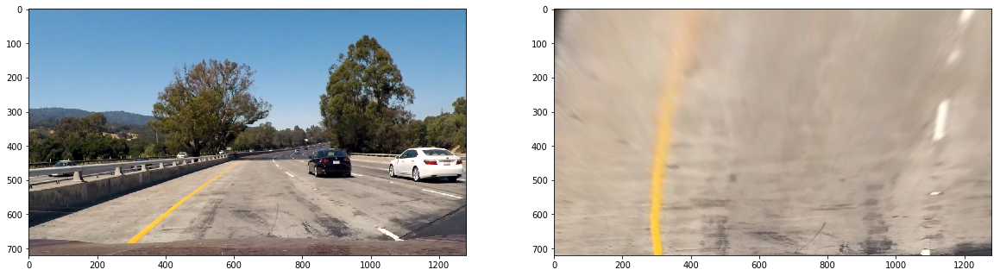

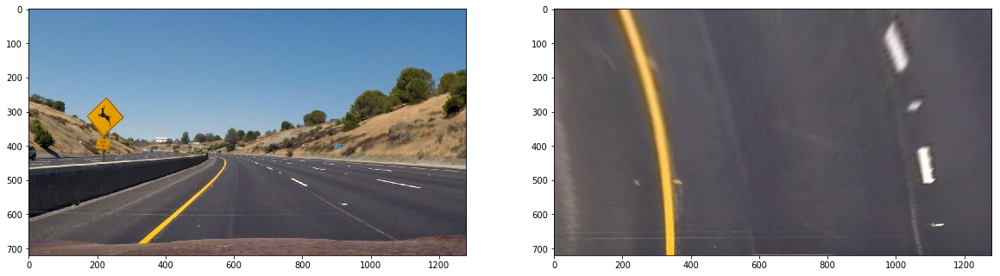

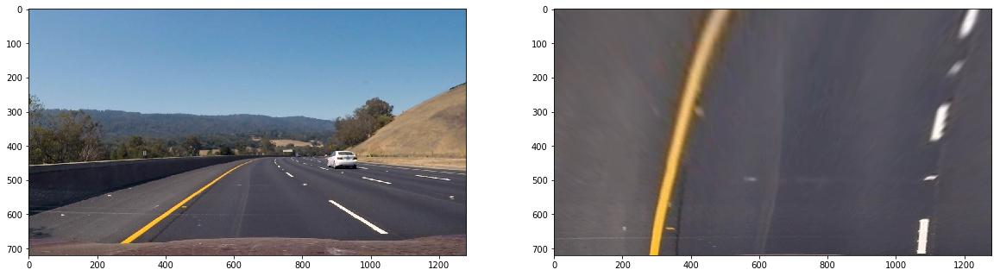

...

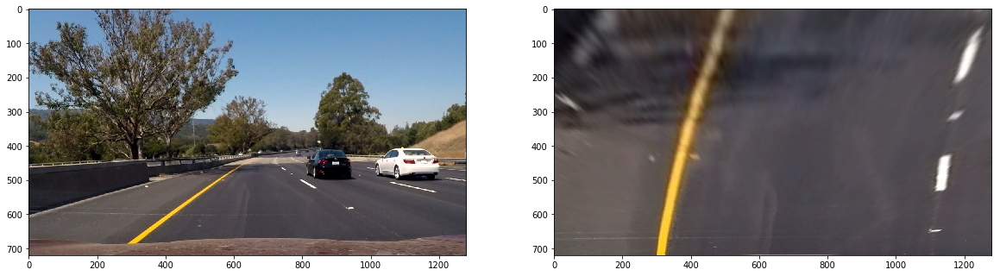

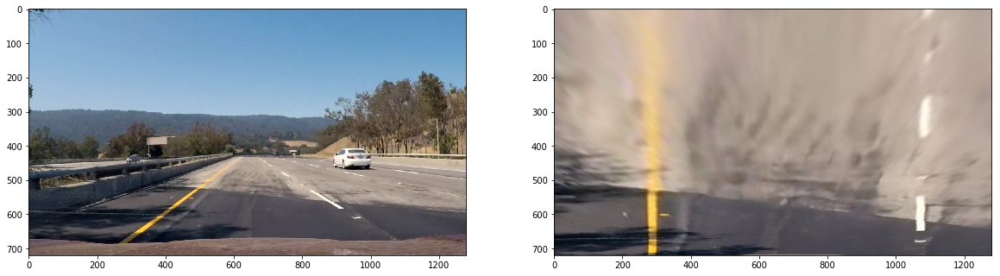

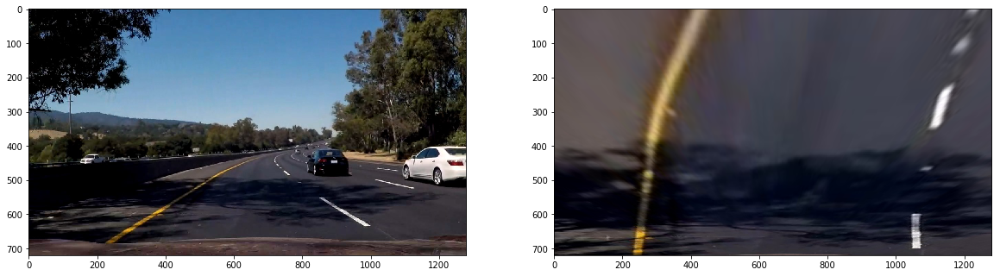

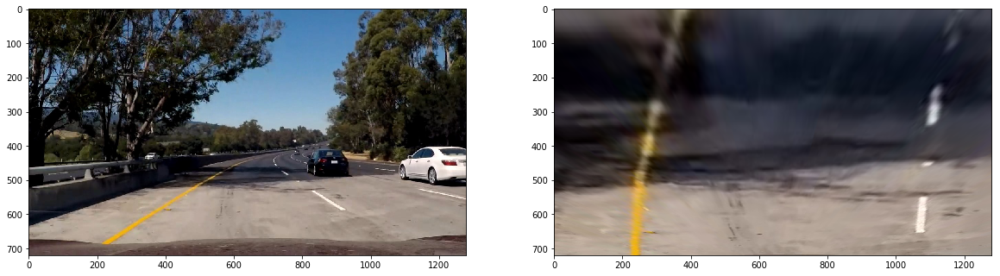

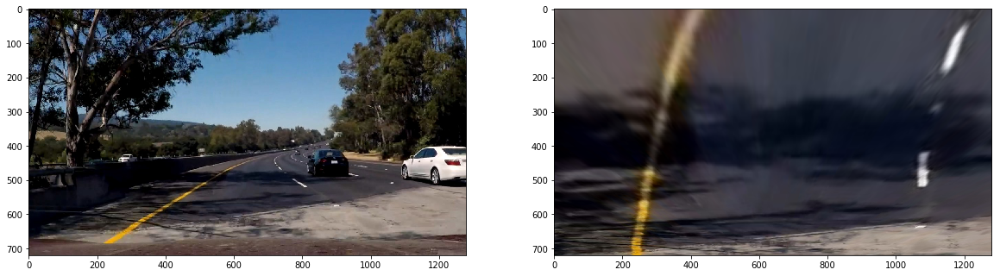

In [14]:
# test the 'warper' function
import string

src =np.float32( [[576,461],[707,461],[254,678],[1056,678]])
dst = np.float32([[254,50],[1056,50],[254,719],[1056,719]])
# apply on test images
for fname in images:
    fig = plt.figure(figsize=(20, 10))
    fig.add_subplot(1,2,1)
    img = cv2.imread(fname)
    plt.imshow(img[...,::-1])
    img = undistort(img)
    wrimg = warper(img,src,dst)
    fig.add_subplot(1,2,2)
    plt.imshow(wrimg[...,::-1])
    plt.show(block=True)
    
    savefname = fname.replace('test_images','output_images')
    cv2.imwrite(savefname,wrimg)


In [15]:
# -----------------------------------------------------------
# create thresholded binary image
# -----------------------------------------------------------


In [16]:
#4. Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?

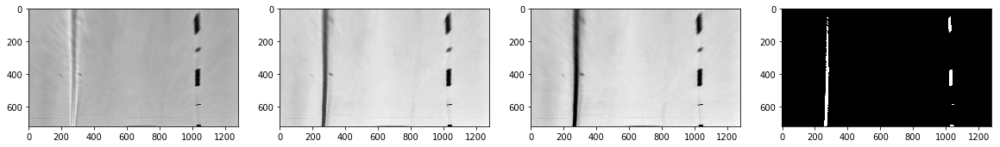

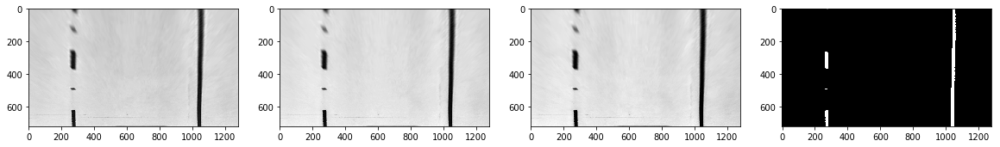

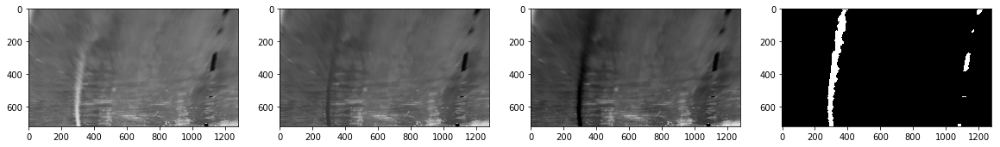

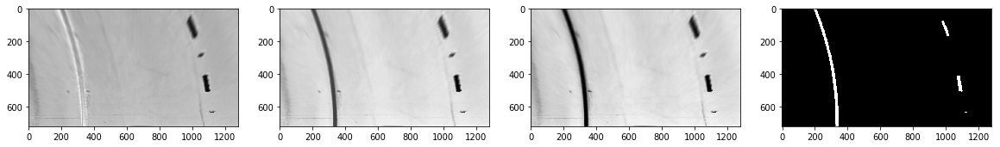

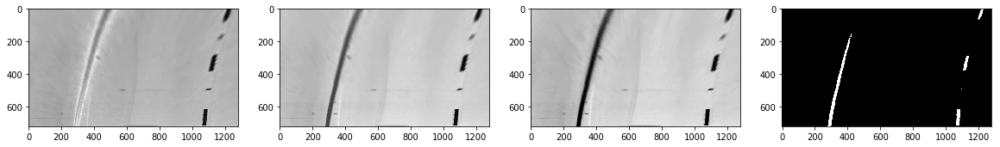

...

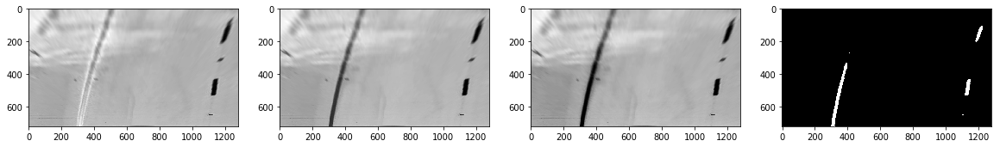

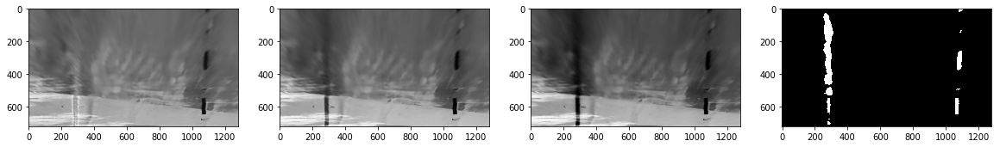

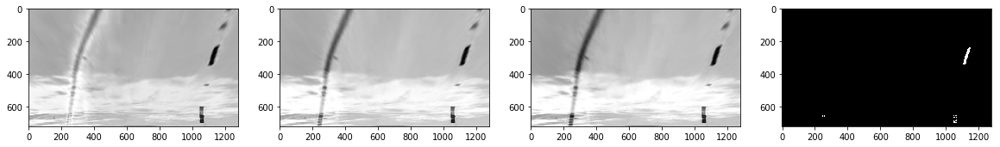

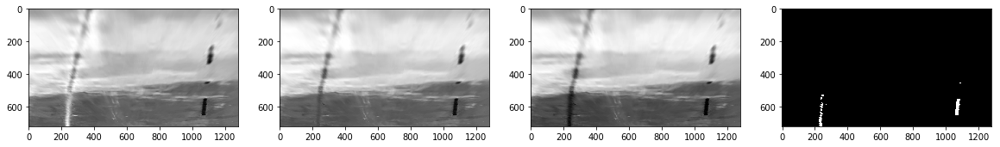

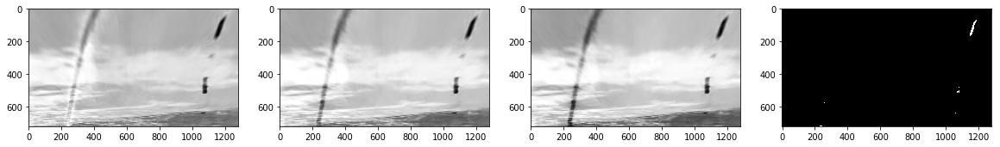

In [17]:
# test to see if I can get any useful information from the CMYK color space channels 
for fname in images:
    image = cv2.imread(fname)         # load the most difficult image to read
    image = undistort(image)                            # undistort the image
    image = warper(image,src,dst)                       # unwrap the image
    image = Image.fromarray(image)                      # convert the image to pollow Image
    image = image.convert('CMYK')                       # convert the image to CMYK format

    c,m,y,k = image.split()                             # seperate the color channels
    fig = plt.figure(figsize=(20, 10))
    fig.add_subplot(1,4,1)
    plt.imshow(np.asarray(c), cmap="gray")              # display the cyan color channel
    fig.add_subplot(1,4,2)
    plt.imshow(np.asarray(m), cmap="gray")              # display the magenta color channel
    fig.add_subplot(1,4,3)
    plt.imshow(np.asarray(y), cmap="gray")              # display the yellow color chanel. I expect it to display the left line clearly
    fig.add_subplot(1,4,4)
    plt.imshow(np.asarray(y)<30, cmap="gray")           # By applying a threshold at Yellow channel of the CMYK image, I can get the yellow line
    plt.show(block=True)


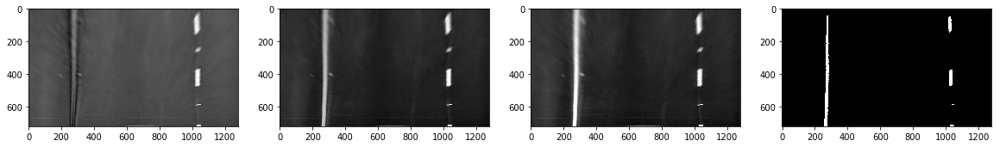

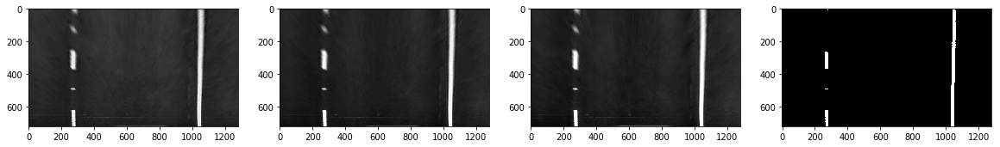

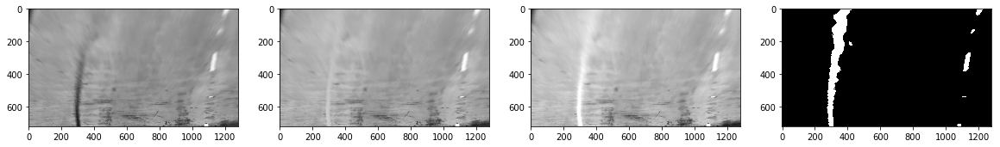

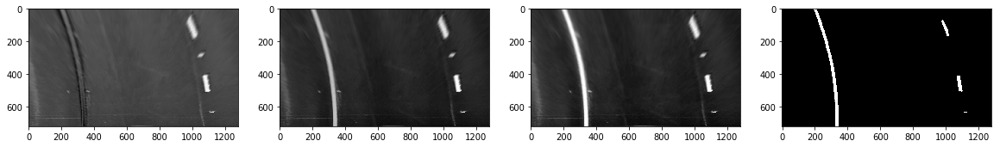

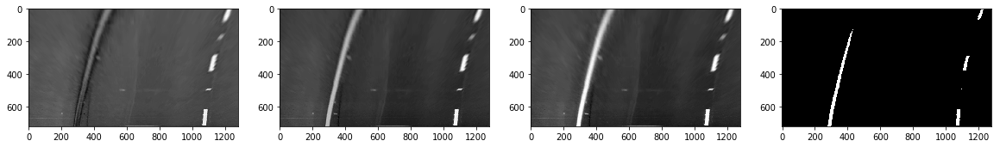

...

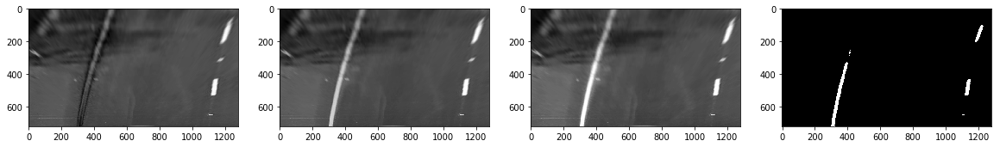

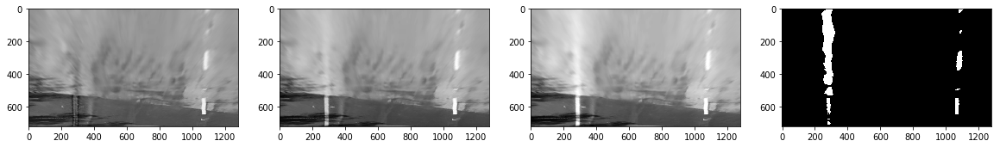

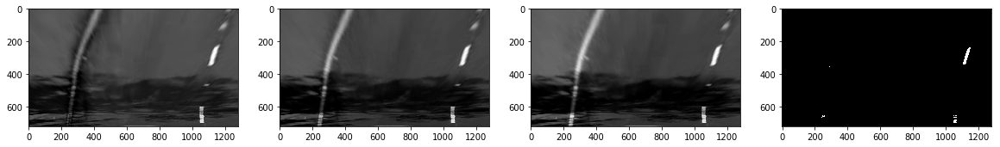

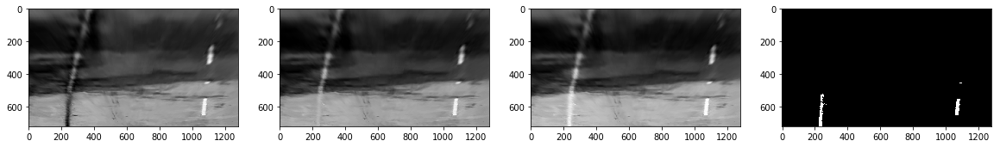

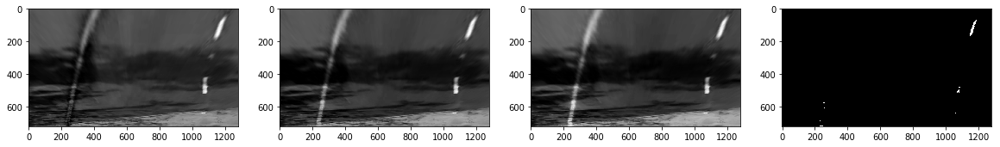

In [18]:
# test to see if I can get any useful information from the RGB color space channels 
for fname in images:
    image = cv2.imread(fname)         # load the most difficult image to read
    image = undistort(image)                            # undistort the image
    image = warper(image,src,dst)                       # unwrap the image
    image = Image.fromarray(image)                      # convert the image to pollow Image
    image = image.convert('RGB')                       # convert the image to CMYK format

    r,g,b = image.split()                             # seperate the color channels
    fig = plt.figure(figsize=(20, 10))
    fig.add_subplot(1,4,1)
    plt.imshow(np.asarray(r), cmap="gray")              # display the cyan color channel
    fig.add_subplot(1,4,2)
    plt.imshow(np.asarray(g), cmap="gray")              # display the magenta color channel
    fig.add_subplot(1,4,3)
    plt.imshow(np.asarray(b), cmap="gray")              # display the yellow color chanel. I expect it to display the left line clearly
    fig.add_subplot(1,4,4)
    plt.imshow(np.asarray(b)>220, cmap="gray")           # By applying a threshold at blue channel of the RGB image, I can get the yellow line
    plt.show(block=True)


In [19]:
def abs_sobel_thresh(img, orient='x',sobel_kernel=3, thresh=(0,255)):
    if len(img.shape) == 3:                              # if img is RGB, convert to monochrome
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    else:                                                  
        gray = img
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize=sobel_kernel)
    if orient == 'y':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize=sobel_kernel)
    # 3) Take the absolute value of the derivative or gradient
    abs = np.absolute(sobel)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled = np.uint8(255*abs/np.max(abs))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
    sbin = np.zeros_like(scaled)
            # is > thresh_min and < thresh_max
    sbin[(scaled >= thresh[0]) & (scaled <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    return sbin

In [20]:
def abs_sobel_thresh_S(img, orient='x',sobel_kernel = 3, thresh=(0,255)):
    
    if len(img.shape) == 3:                              # if img is RGB, convert to monochrome
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        s_channel = gray[:,:,2]    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    else:                                                  
        s_channel = gray
    return abs_sobel_thresh(s_channel,orient,sobel_kernel,thresh)

In [21]:
def mag_thresh(img, sobel_kernel=3, thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    if len(img.shape) == 3:                              # if img is RGB, convert to monochrome
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    else:                                                  
        gray = img
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize = sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize = sobel_kernel)
    # 3) Calculate the magnitude 
    sobelxy = np.sqrt(np.power(sobelx,2) + np.power(sobely,2))
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    abs = np.absolute(sobelxy)
    scaled = np.uint8(255*abs/np.max(abs))
    # 5) Create a binary mask where mag thresholds are met
    bin = np.zeros_like(scaled)
    bin[(scaled >= thresh[0]) * (scaled <= thresh[1])] =1
    # 6) Return this mask as your binary_output image
    return bin

In [22]:
def mag_thresh_S(img, sobel_kernel=3, thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    if len(img.shape) == 3:                              # if img is RGB, convert to HLS and get the S channel
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
        s_channel = gray[:,:,2]
    else:                                                  
        s_channel = img                                   # I assume that the input is the S channel, there is no way to know the type of a monochrome input image
    return mag_thresh(s_channel,sobel_kernel, thresh)

In [23]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    if len(img.shape) == 3:                              # if img is RGB, convert to monochrome
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    else:                                                  
        gray = img
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray,cv2.CV_64F,1,0,ksize=sobel_kernel)
    sobely = cv2.Sobel(gray,cv2.CV_64F,0,1,ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    absx = np.absolute(sobelx)
    absy = np.absolute(sobely)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient
    direction = np.arctan2(absy,absx)
    # 5) Create a binary mask where direction thresholds are met
    bin = np.zeros_like(direction)
    bin[(direction>=thresh[0]) & (direction<=thresh[1])]=1
    # 6) Return this mask as your binary_output image
    return bin

In [24]:
def dir_threshold_S(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    if len(img.shape) == 3:                              # if img is RGB, convert to monochrome
        image = cv2.cvtColor (img,cv2.COLOR_RGB2HLS)
        s_channel = image[:,:,2]
    else:                                                  
        s_channel = img
    return dir_threshold(s_channel,sobel_kernel,thresh)
    

In [25]:
def b_threshold (img,thresh=150):
    if len(img.shape) ==3:
        LAB = cv2.cvtColor(img, cv2.COLOR_RGB2LAB)
        B = LAB[:,:,2]
    else:
        B = img
    bin = np.zeros_like(B)
    bin[(B>= thresh)]=1
    return bin

In [26]:
def yellow_threshold(img,thresh=20):   # get the yellow channel from the CMYK color space 
    image = Image.fromarray(img)
    image = image.convert('CMYK')
    c,m,y,k = image.split()
    y=np.array(y)
    bin = np.zeros_like(y)
    bin[(y<=thresh)]=1
    return bin

In [27]:
def combined(image, ksize =3): # image should be in RGB color format
    
    image = cv2.bilateralFilter(image,7,60,60)
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20,100))
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(20, 150)) 
    mag_binary = mag_thresh(image, sobel_kernel=ksize, thresh=(130, 255))
    dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0.6, 1.4))
    gradx_s = abs_sobel_thresh_S(image, orient='x', sobel_kernel=ksize, thresh=(20,150))
    grady_s = abs_sobel_thresh_S(image, orient='y', sobel_kernel=ksize, thresh=(20, 150)) 
    mag_binary_s = mag_thresh_S(image, sobel_kernel=ksize, thresh=(130, 255))
    dir_binary_s = dir_threshold_S(image, sobel_kernel=ksize, thresh=(0.6, 1.4))
    b = b_threshold (image,150)
    yellow_line = yellow_threshold(image,30)
    combined = np.zeros_like(dir_binary)  
    combined[(((gradx == 1) & (grady == 1)) | ((gradx_s == 1) & (grady_s == 1)) | (b ==1) | ((mag_binary == 1) & (dir_binary == 1)) | (yellow_line==1) ) ] = 1
    
    return combined

In [28]:
def processThresholdedFrame(image):  # it returns the thresholded image 
 #   image = image[...,::-1]
    image = undistort(image)
    image = warper(image,src,dst)
    c = combined(image,kernelsize)
    c = c * 255/np.max(c)
    c = np.array(cv2.merge((c,c,c)),np.uint8)  # gray to RGB
    # c = np.array(c*255,dtype=np.uint8)      # binary
    return  c

In [29]:
def close_clip(clip):  # close the video clip and release the resources
        try:
                clip.reader.close()
                del clip.reader
                if clip.audio != None:
                        clip.audio.reader.close_proc()
                        del clip.audio
                del clip
        except Exception as e:
                sys.exc_clear()

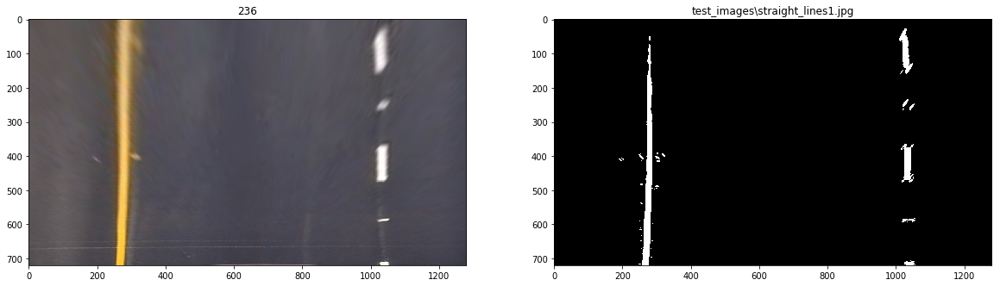

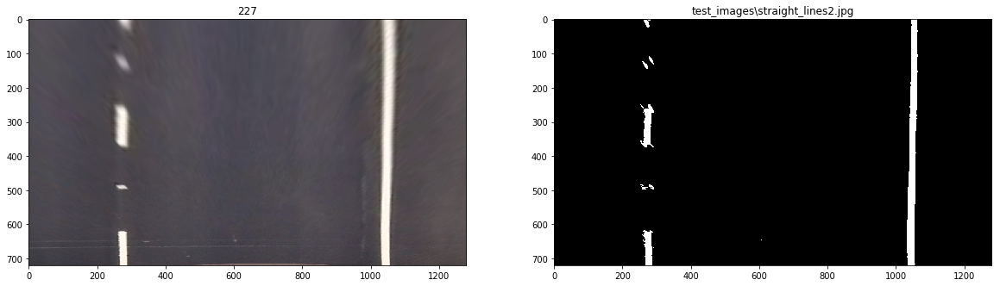

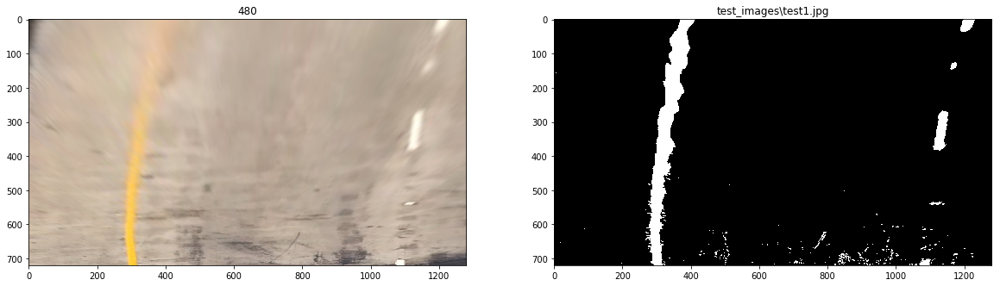

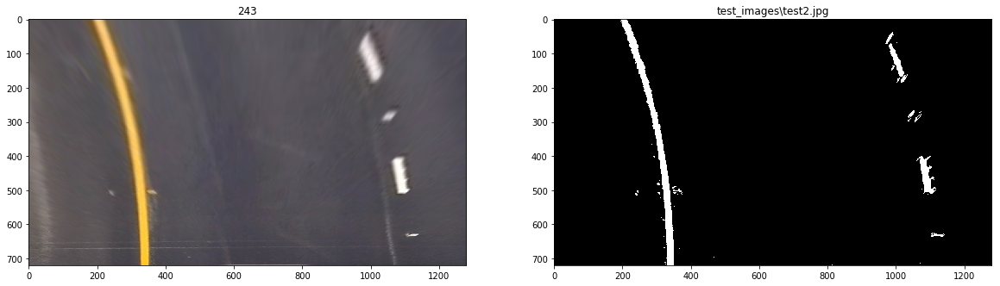

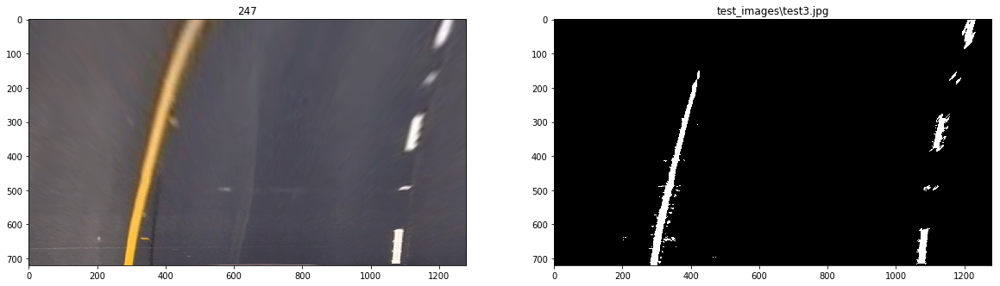

...

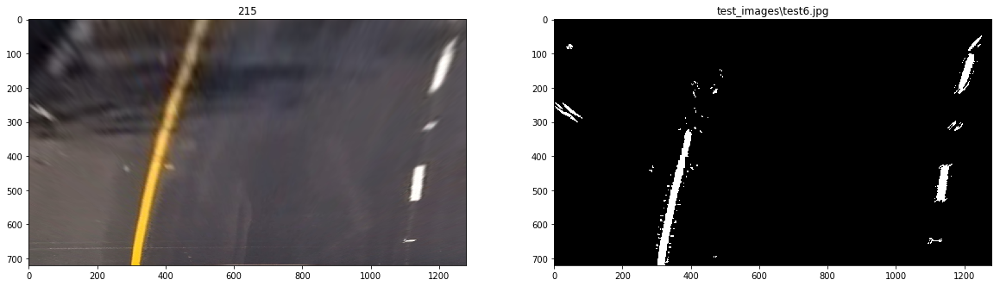

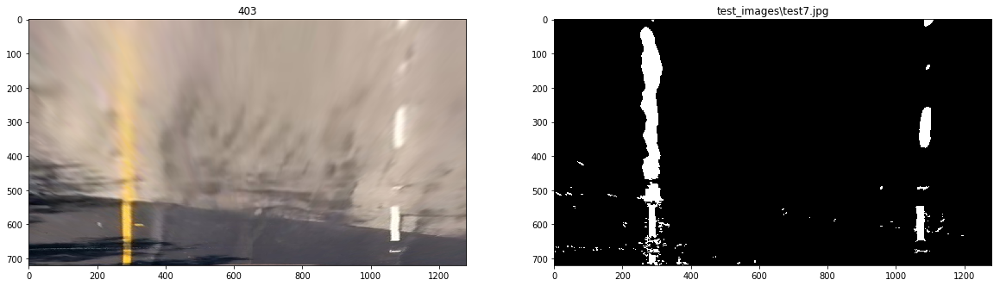

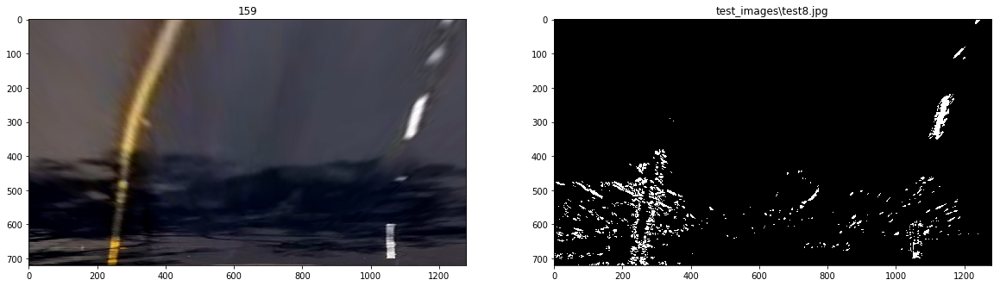

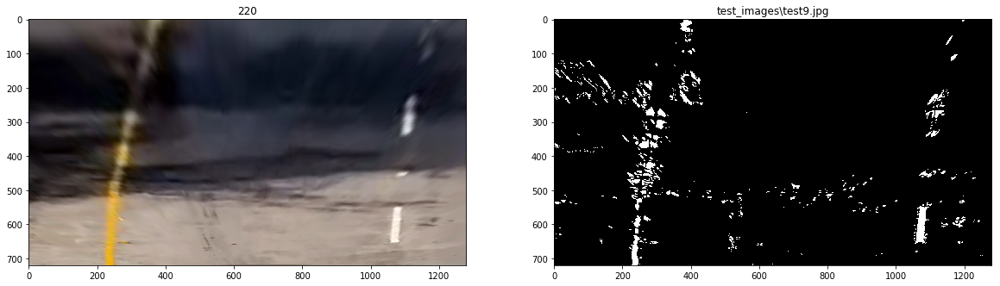

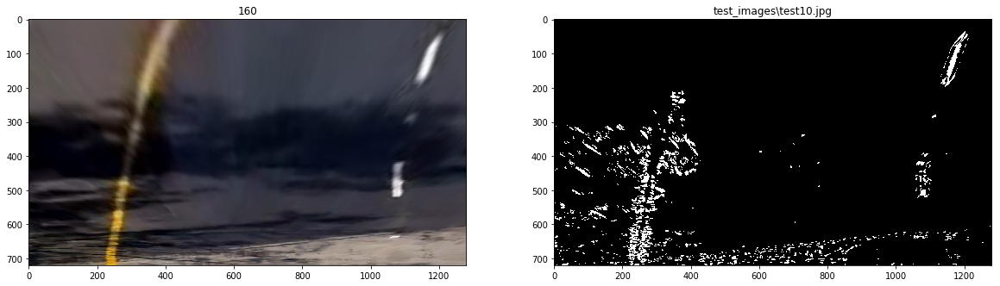

In [30]:
# thresholded binary image test
kernelsize=9
for fname in images: #zero_channel
    fig = plt.figure(figsize=(20, 10))
    fig.add_subplot(1,2,1)
    frame = cv2.imread(fname)
    
    image = undistort(frame)
    image = warper(image,src,dst)
    plt.title(str(np.sum(image)//1000000))   # brightness indicator. Lower values indicate darker frame
    plt.imshow(image[...,::-1])
    fig.add_subplot(1,2,2)

    t = processThresholdedFrame(frame)
    plt.title(fname)
    plt.imshow(t)
    plt.show(block=True)

In [31]:
if create_preview_video == True:
    # create a thresholded 
    source = VideoFileClip("project_video.mp4")
    output = source.fl_image(processThresholdedFrame) 
    %time output.write_videofile('thresholded_project_video.mp4', audio=False, progress_bar=True)
    close_clip(source)

In [32]:
%%HTML
<video controls width="100%" controls>
  <source src="thresholded_project_video.mp4" type="video/mp4">
</video>

In [33]:
# -----------------------------------------------------------
# Detect lane pixels and fit to find the lane boundary.
# -----------------------------------------------------------

In [34]:
def window_mask(width, height, img_ref, center_x,center_y):
    output = np.zeros_like(img_ref)
    xmin = max(0,int(center_x - width/2))
    xmax = min(int(center_x + width/2), img_ref.shape[1])
    ymin = int(center_y - height/2)
    ymax = int(center_y + height/2)
    output[ ymin : ymax , xmin : xmax ] = 1
    return output

In [35]:
def level_Y(level,height,window_height):
    result = image.shape[0] - (window_height  * level) - window_height//2
    return result

In [36]:
def find_centroids(image, window_width, window_height, margin, leftOrRight = 'left'):
    window_centroids = [] # Store the window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions

    # if there is not a line visible in the window, the search window width is doubled in the next layer
    valid_threshold = 0.0
    temp_margin = margin
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    if leftOrRight == 'left': # find the left lane line
        sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
        center = np.argmax(np.convolve(window,sum))-window_width//2
    else:                     # find the right lane line
        sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
        center = np.argmax(np.convolve(window,sum))-window_width//2+int(image.shape[1]//2)
    
    # Add what we found for the first layer
    window_centroids.append((center,image.shape[0] - window_height//2))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(np.ones(window_width), image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset =window_width//2
        min_index = int(max(center+offset-temp_margin,0))
        max_index = int(min(center+offset+temp_margin,image.shape[1]))
        center = np.argmax(conv_signal[min_index:max_index])+min_index-offset
        if valid_threshold >= np.max(conv_signal[min_index:max_index]):  # if no line is vissible in this layer
            temp_margin = 2 *temp_margin                                # search in a wider area in the next level
        else:
            # Add what we found for that layer
             
            window_centroids.append((center,level_Y(level,image.shape[0],window_height)))
            temp_margin = margin
    # the function returns the (X,Y) coordinates of the boxes in image goordingates 
    return window_centroids

In [37]:
def find_window_centroids(image, window_width, window_height, margin):
    window_centroids =[]
    left_centroids = find_centroids (image,window_width, window_height, margin,'left')
    right_centroids = find_centroids (image,window_width, window_height, margin,'right')
    window_centroids.append((left_centroids,right_centroids))
    return window_centroids

In [38]:
def drawCentroidsTemplate(image,centroids):
    points = np.zeros_like(warped)
    # If we found any window centers
    if len(centroids) > 0:
        # Points used to draw all the left windows
        
        # Go through each level and draw the windows 	
        for centroid in centroids:
            # Window_mask is a function to draw window areas
            mask = window_mask(window_width,window_height,warped,centroid[0],centroid[1])
            # Add graphic points from window mask here to total pixels found 
            points[(points == 255) | ((mask == 1) ) ] = 255
        template = np.array(points,np.uint8)
        return template
    else:
        return np.array(points,np.uint8)

In [39]:
def drawCentroidsOverlay(warped, returnTemplate = False):  # if returnTemplate it true, only the overlaytemplate is returned
    centroids = find_window_centroids(warped, window_width, window_height, margin)
    left_centroids = centroids [0][0]
    right_centroids = centroids [0][1]
    zero_channel = np.array(np.zeros_like(warped[::1]),np.uint8) # create a zero color channel
    if debug == True:
        print('Left centroids : ' + str(left_centroids))
        print('Right centroids : ' + str(right_centroids))
    if (len(left_centroids) > 0 ) or (len(right_centroids) > 0):
        l_template = drawCentroidsTemplate(warped,left_centroids)
        r_template = drawCentroidsTemplate(warped,right_centroids)
        # template = np.array(cv2.merge((r_template,l_template,np.uint8(warped*255))),np.uint8) # make window pixels green for the left line and red for the right line
        template = np.array(cv2.merge((r_template,l_template,zero_channel)),np.uint8) # make window pixels green for the left line and red for the right line
        #warpage= np.dstack((warped, warped, warped))*255 # making the original road pixels 3 color channels
        if returnTemplate == False:
            output = cv2.addWeighted(image, 1.0, template, 0.5, 0.0) # overlay the orignal road image with window results
        else:
            output = temmplat
    # If no window centers found, just display orginal road image
    else:
        if returnTemplate == False:
            output = np.array(cv2.merge((warped,warped,warped)),np.uint8)
        else:
            output = np.array(cv2.merge((zero_channel,zero_channel,zero_channel)),np.uint8)
    return output

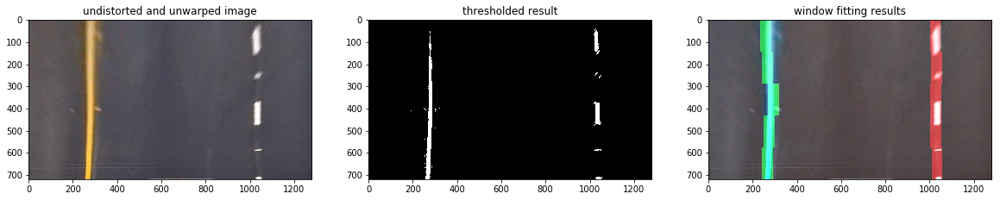

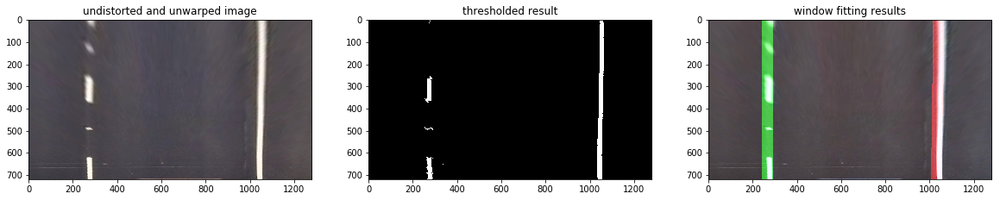

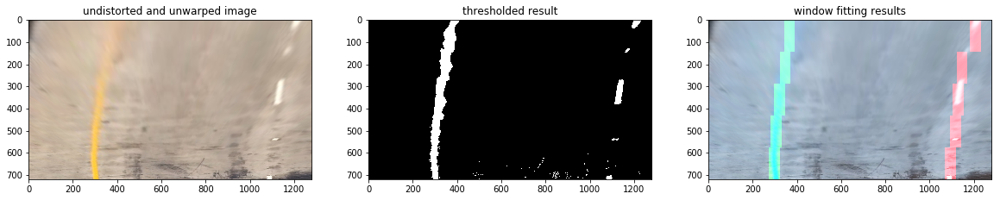

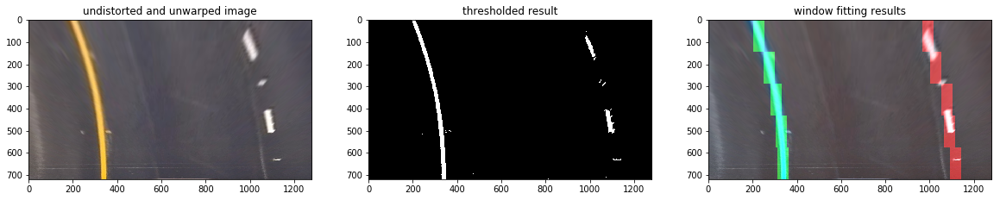

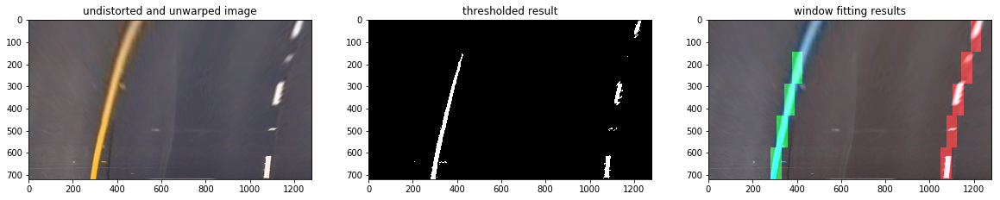

...

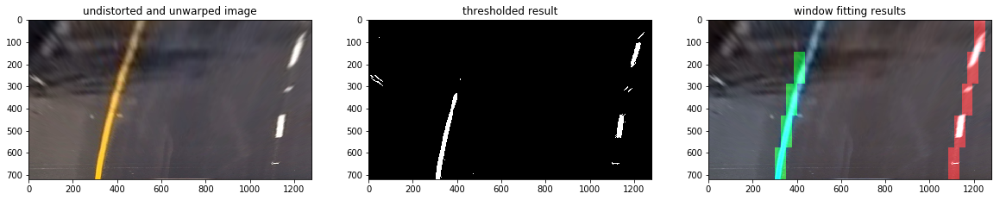

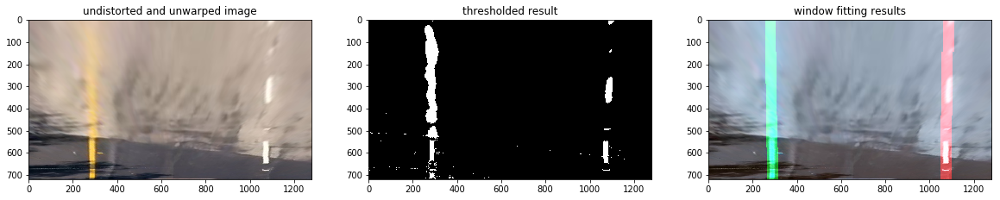

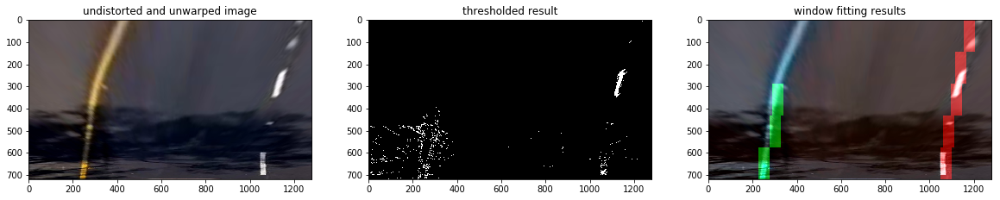

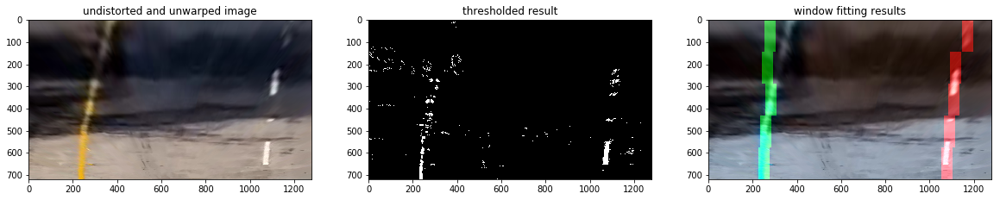

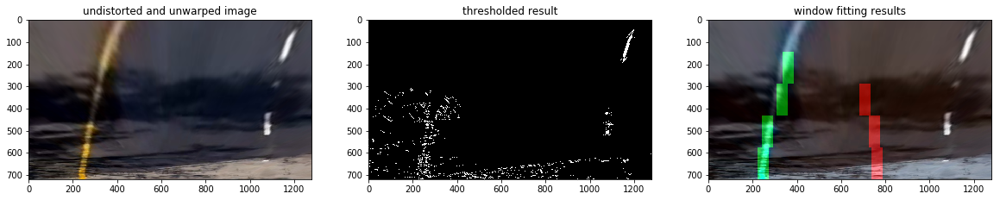

In [40]:
for fname in images:
    image = cv2.imread(fname)
    image = undistort(image)
    image = warper(image,src,dst)
    warped = combined(image,kernelsize)
    
    output = drawCentroidsOverlay(warped)
    # Display the final results
    
    fig = plt.figure(figsize=(20, 10))
    #fig.suptitle(fname)
    fig.add_subplot(1,3,1)
    plt.title("undistorted and unwarped image")
    plt.imshow(image[...,::-1]) # convert to RBG
    fig.add_subplot(1,3,2)
    plt.title("thresholded result")
    plt.imshow(combined(image),cmap='gray')
    fig.add_subplot(1,3,3)
    plt.imshow(output)
    
    plt.title('window fitting results')
    plt.show()
    plt.show(block=True)


In [41]:
if create_preview_video == True:
    cap = cv2.VideoCapture('project_video.mp4')
    i = 0
    frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    while(cap.isOpened()):
        ret, frame = cap.read()
        i = i + 1
        image = undistort(frame)
        image = warper(image,src,dst)
        warped = combined(image,kernelsize)
        output = drawCentroidsOverlay(warped)
        # Display the final results

        fig = plt.figure(figsize=(20, 10))
        #fig.suptitle(fname)
        fig.add_subplot(1,3,1)
        plt.title("undistorted and unwarped frame #" + str(i))
        plt.imshow(image[...,::-1]) # convert to RBG
        fig.add_subplot(1,3,2)
        plt.title("thresholded result")
        plt.imshow(combined(image),cmap='gray')
        fig.add_subplot(1,3,3)
        plt.imshow(output)

        plt.title('window fitting results')
        plt.show()
        plt.show(block=True)


    cap.release()
    cv2.destroyAllWindows()

In [42]:
from enum import Enum
class Status (Enum):
    VALID = 0
    ESTIMATED = 1
    INVALID = 2
    NODATA = 3

In [43]:
class LineType (Enum):
    Left = 0
    Right = 1

In [44]:

def getStatusMessage(status):
    if status == Status.VALID:
        return "Valid"
    elif status == Status.ESTIMATED:
        return "Estimated"
    elif status == Status.NODATA:
        return "No data"
    else:
        return "Invalid data"

In [45]:
ym_per_pix = 30/720                         # meters per pixel in y dimension
xm_per_pix = 3.7/800                        # meters per pixel in x dimension

In [46]:
class Line():
    def __init__(self, type = LineType.Left):
        # what is the status of the line detection in the last iteration?
        self.status = Status.NODATA  
        #polynomial coefficients for the most recent fit
        self.fit = [np.array([False])]  
        #radius of curvature of the line in meters
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None  
        #x values for detected line pixels on the last n updates
        self.allx = []
        #y values for detected line pixels on the last n updates
        self.ally = []
        # number of last fits to use
        self.n = 7
        # number of centroids per update
        self.centroidsPerUpdate =[]
        # Is it the left or the right line?
        self.lineType = type
        # displacement from the previous frame
        self.displacement = 0
    def reset(self):
        # what is the status of the line detection in the last iteration?
        self.status = Status.NODATA  
        #polynomial coefficients for the most recent fit
        self.fit = [np.array([False])]  
        #radius of curvature of the line in meters
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None  
        #x values for detected line pixels on the last n updates
        self.allx = []
        #y values for detected line pixels on the last n updates
        self.ally = []
        # number of last fits to usecentroidsPerUpdate
        self.n = 7
        # number of centroids per update
        self.centroidsPerUpdate =[]
        # Is it the left or the right line?
        self.lineType = type
        # the displacement from the previous to the current frame
        self.displacement = 0
    def updateIsValid(self,newx): # check if the update centroids are close to the previous centroids
        validThreshold = 200      
        if abs(self.displacement)<validThreshold:
            return True
        else:
            return False
    def update (self,centroids):  # update the line with the current frame centroids
        self.status = Status.VALID
        
        arr = np.array(centroids)
        newx = arr[:,0]
        newy = arr[:,1]
        
        if len(self.allx)>0:             # if there are any centroids detected in the last n frames
            newAvg = np.mean(newx)
            allAvg = np.mean(self.allx)
            self.displacement = int( newAvg - allAvg) 
        else:
            self.displacement = 0
        
        if self.updateIsValid(newx) == True: # if the new centroid is close to the line detected in the previous frames
            self.allx.extend(newx)
            self.ally.extend(newy)
            self.centroidsPerUpdate.append(len(centroids))
        else:
            self.status = Status.INVALID
            
        if (len(centroids)<3): # we need at least three points to fit the second order polynomial
            if (len(self.centroidsPerUpdate)>0):  # data from recent updates are available to use for line estimation
                self.status = Status.ESTIMATED
                if debug == True:
                    print('estimated')
            else:                            # no centroids are detected and no recent updates are available 
                if debug == True:
                    print ('no data')
                self.status = Status.NODATA
                
                
        if len(self.centroidsPerUpdate)>self.n:                 # keep only the last n update data
            for counter in range(self.centroidsPerUpdate[0]):   
                self.allx.pop(0)
                self.ally.pop(0)
            self.centroidsPerUpdate.pop(0)
        
        self.raw_fit=np.polyfit(self.ally, self.allx, 2)        # fit a second order polynomial to the centroids. The line may have the same X value in more than one points so the X and Y axis are inverted for fitting
        a = [i*ym_per_pix for i in self.ally]                   # convert from pixels to meters
        b = [i*xm_per_pix for i in self.allx]                   # convert from pixels to meters
        self.fit = np.polyfit(a, b, 2)                          
        
        self.radius_of_curvature = ((1 + (2*self.fit[0]*719*ym_per_pix + self.fit[1])**2)**1.5) / np.absolute(2*self.fit[0]) # Calculate the radius of curvature
        
        
    # get the points for the polygon
    def getPolyPoints (self,LeftLine = 0, minY=0, maxY = 719, points =10 ):
        ploty = np.linspace(minY,maxY,points)
        plotx = self.raw_fit[0]*ploty**2 + self.raw_fit[1]*ploty + self.raw_fit[2]
        pts = np.array([np.transpose(np.vstack([plotx, ploty]))])
        if self.lineType==LineType.Left:
            pts = np.array([np.transpose(np.vstack([plotx, ploty]))])
        else:
            pts = np.array([np.flipud(np.transpose(np.vstack([plotx, ploty])))])
        return pts
        
    def getPlotPoints (self,LeftLine = 0, minY=0, maxY = 719, points =10 ):
        ploty = np.linspace(minY,maxY,points)
        plotx = self.raw_fit[0]*ploty**2 + self.raw_fit[1]*ploty + self.raw_fit[2]
        return (plotx,ploty)
        

In [47]:
def resetDetectedLines():
    left_line.reset()
    right_line.reset()   

In [48]:
font = cv2.FONT_HERSHEY_COMPLEX_SMALL
left_line = Line()
right_line = Line()
def processFrame(image):      
    valid = True
    undistorted = undistort(image)                  # undistort the image
    image = warper(undistorted,src,dst)             # unwarp the image
    warped = combined(image,kernelsize)             # get the thresholded binary image
    window_centroids = find_window_centroids(warped, window_width, window_height, margin)      
    l_centroids = window_centroids[0][0]
    r_centroids = window_centroids[0][1]
    
    left_line.update(l_centroids)
    right_line.update(r_centroids)


    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    pts_left = left_line.getPolyPoints()
    pts_right =  right_line.getPolyPoints()
    pts_right = np.flip(pts_right,1)
    pts = np.hstack((pts_left,pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # -----------------------------------------------------------
    # Warp the blank back to original image space using 
    # inverse perspective matrix (Minv)
    # -----------------------------------------------------------
    Minv = cv2.getPerspectiveTransform( dst,src)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    result = cv2.addWeighted(undistorted, 1,newwarp, 0.3, 0)

    # -----------------------------------------------------------
    # Output visual display of the lane boundaries and numerical 
    # estimation of lane curvature and vehicle position.
    # -----------------------------------------------------------

    # Display the radius of curvature and the distance from the center of the lane
    avg_curv = (left_line.radius_of_curvature + right_line.radius_of_curvature)*0.5
    avg_curv_str = "Radius of Curvature: " + "{:10.2f}".format(avg_curv) + "m"
    car_position = (pts_left[0][:][-1][0]+pts_right[0][:][-1][0])*0.5
    car_position = 1280*0.5-car_position
    car_position = car_position * xm_per_pix
    if car_position>0:
        msg = "{:10.2f}".format(car_position) + "m left of center"
    elif car_position<0:
        car_position = -car_position
        msg = "{:10.2f}".format(car_position) + "m right of center"
    else:
        msg = "Centered"
    cv2.putText(result,avg_curv_str,(10,60), font, 2,(255,255,255),2,cv2.LINE_AA)
    cv2.putText(result,msg,(-130,120), font, 2,(255,255,255),2,cv2.LINE_AA)        
    if debug == True:
        cv2.putText(result,"Left line: " + getStatusMessage(left_line.status),(0,180), font, 2,(255,255,255),2,cv2.LINE_AA)        
        cv2.putText(result,"Right line: " + getStatusMessage(right_line.status),(0,240), font, 2,(255,255,255),2,cv2.LINE_AA)        
        cv2.putText(result,"rDisp: " + str(left_line.displacement) + "  lDisp: " + str(right_line.displacement),(0,300), font, 2,(255,255,255),2,cv2.LINE_AA)
        
    if avg_curv <500:  # the road is expected to have radius greather than 643m due to the U.S. government specifications for highway curvature. 
        valid = False
    return result

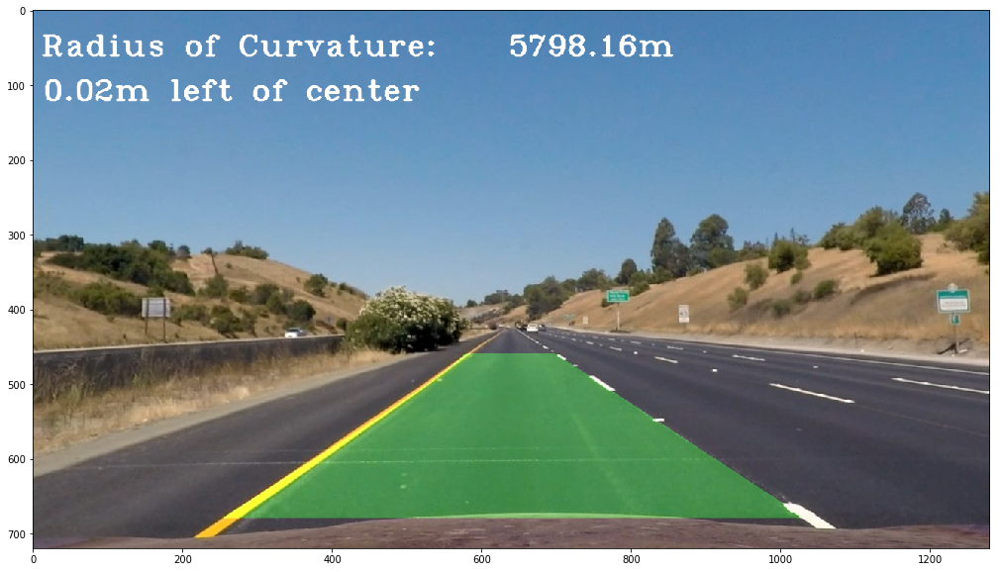

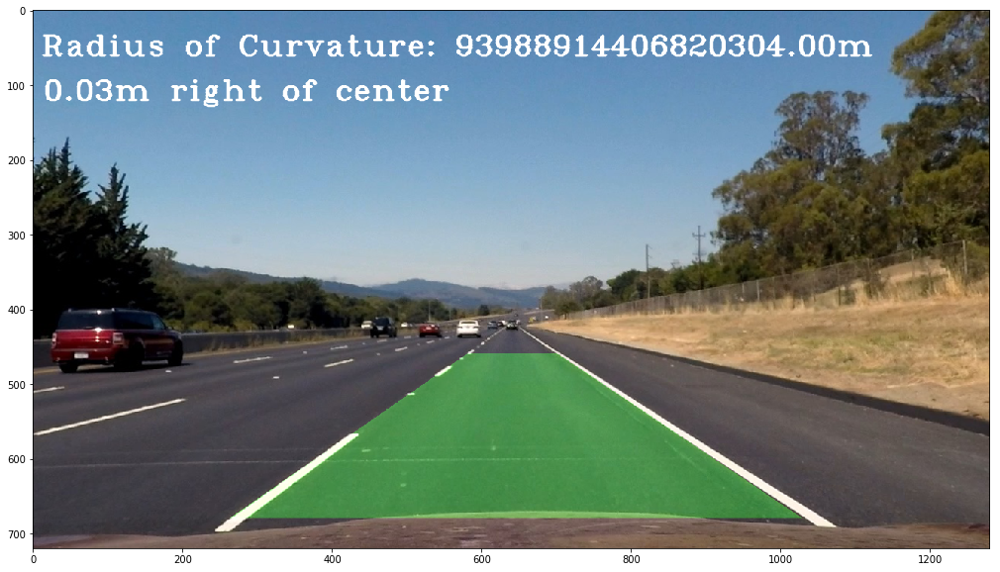

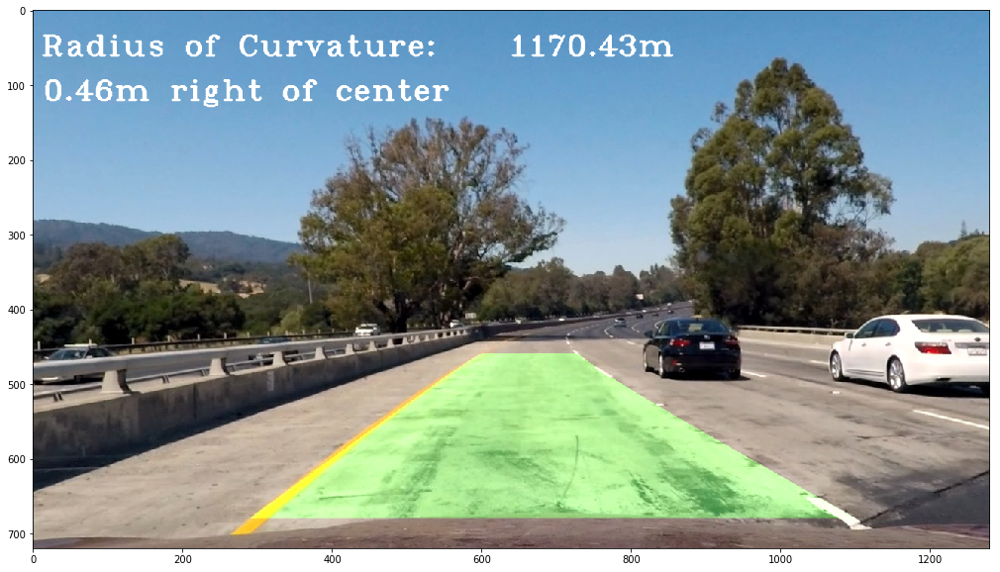

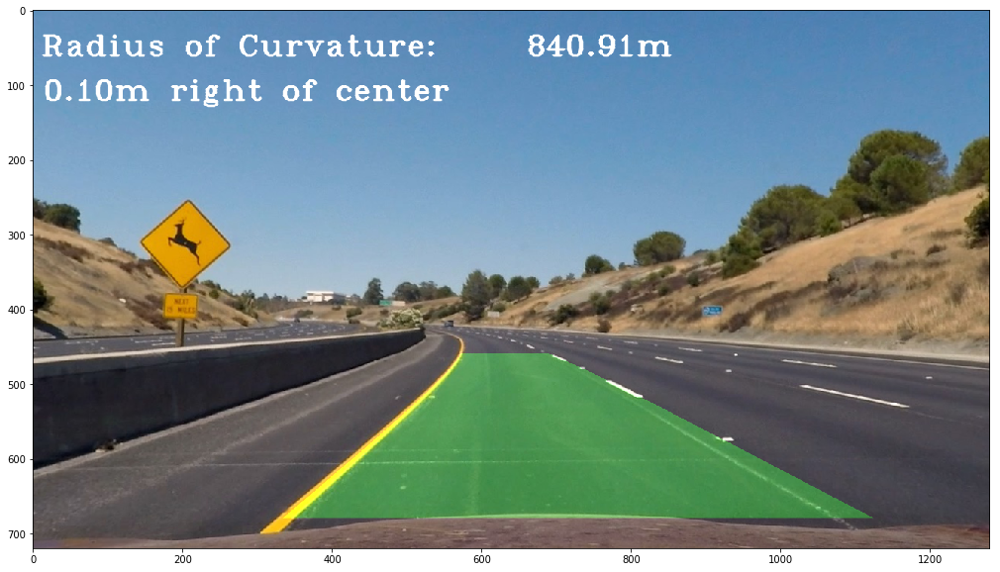

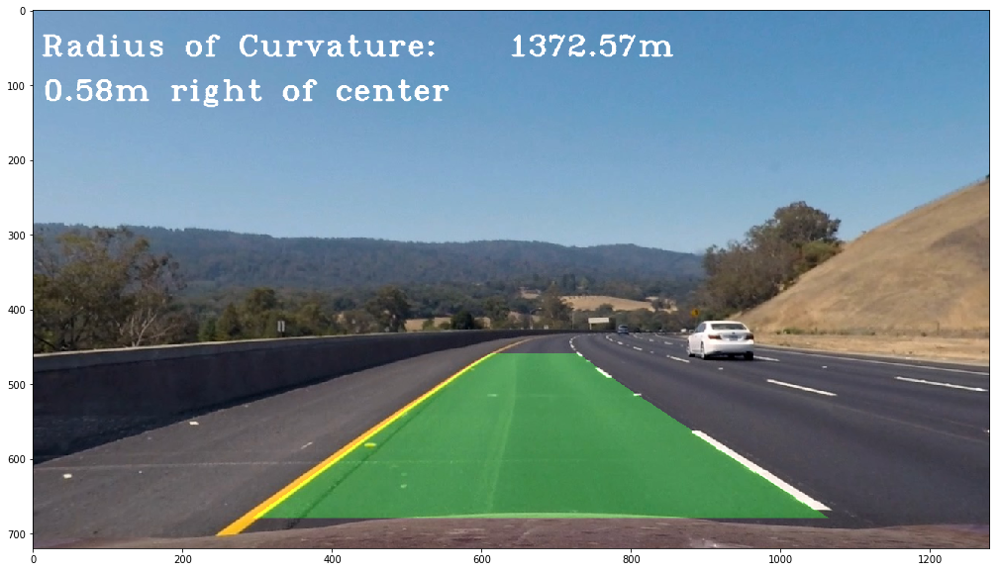

...

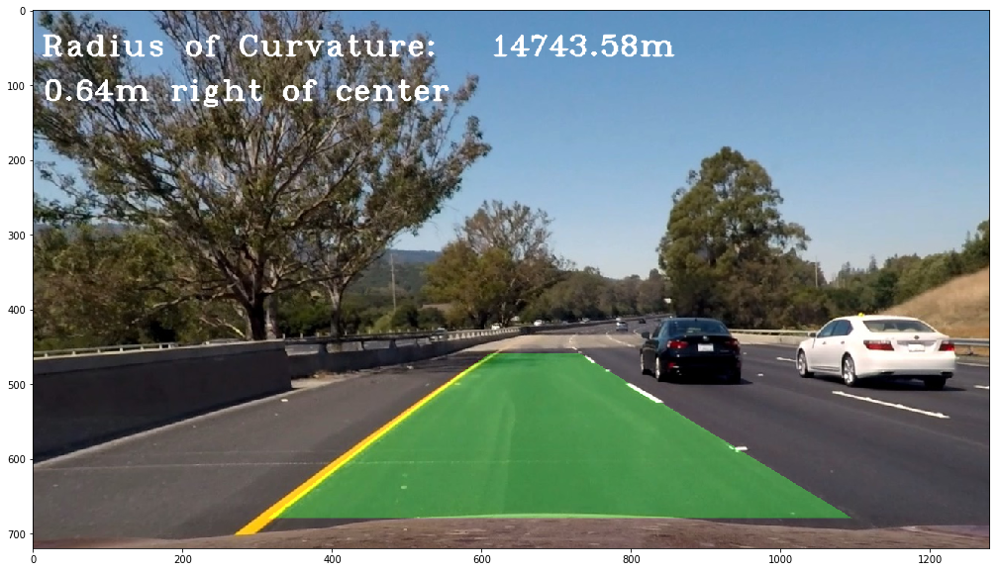

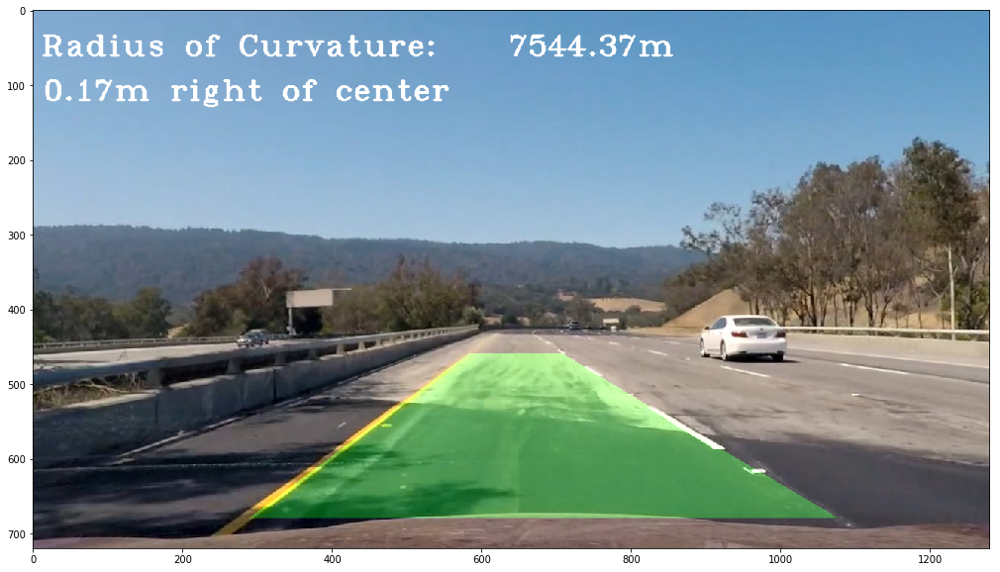

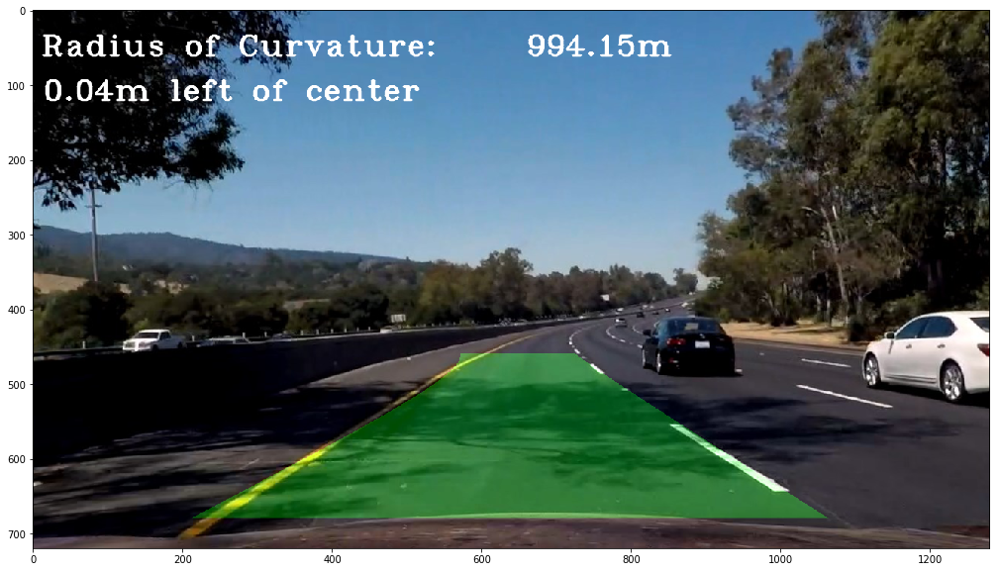

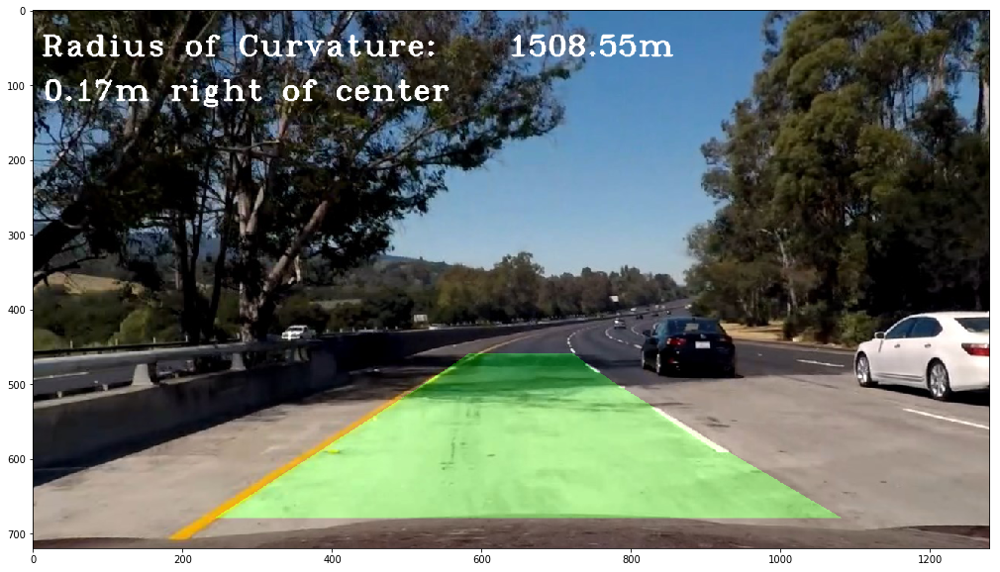

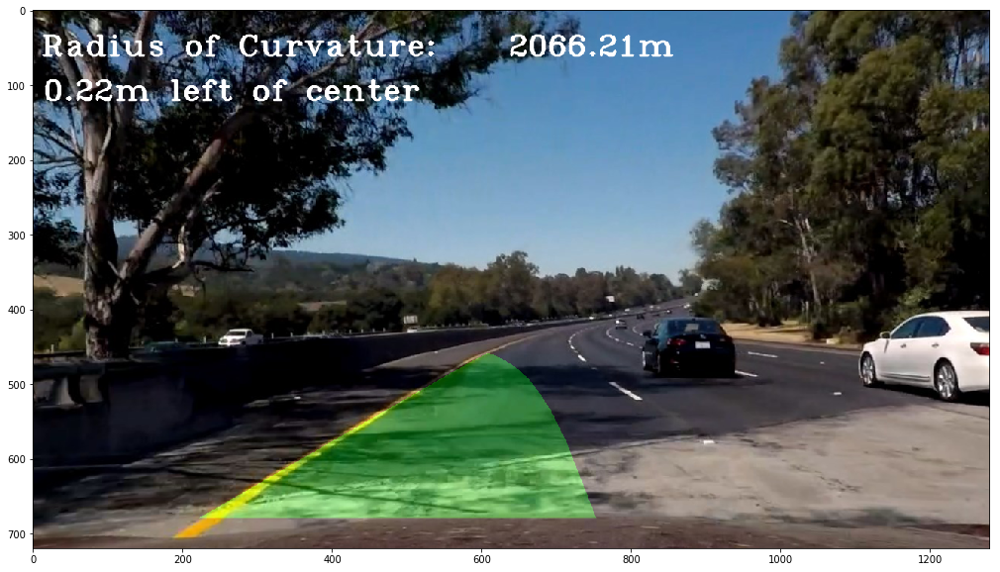

In [49]:
for fname in images:
    resetDetectedLines()
    image = cv2.imread(fname)
    fig = plt.figure(figsize=(20, 10))
    plt.imshow(processFrame(image)[...,::-1])
    

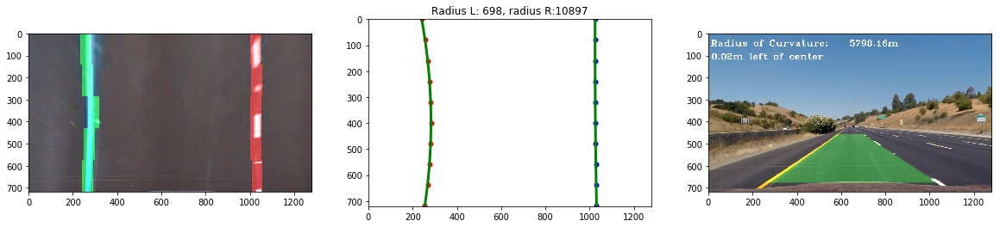

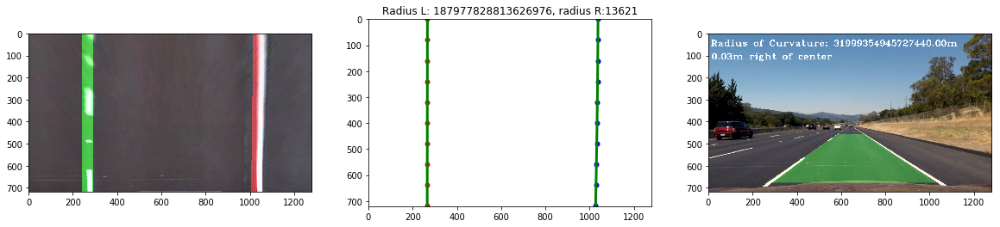

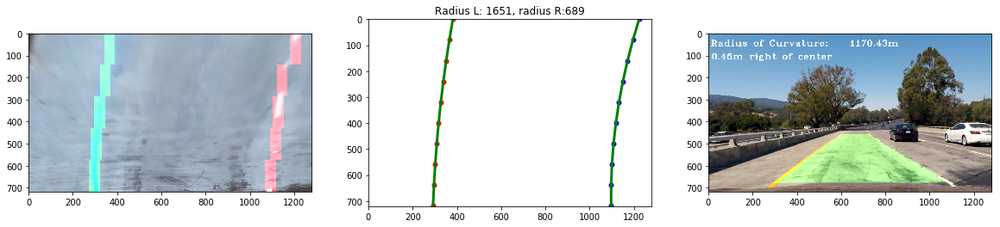

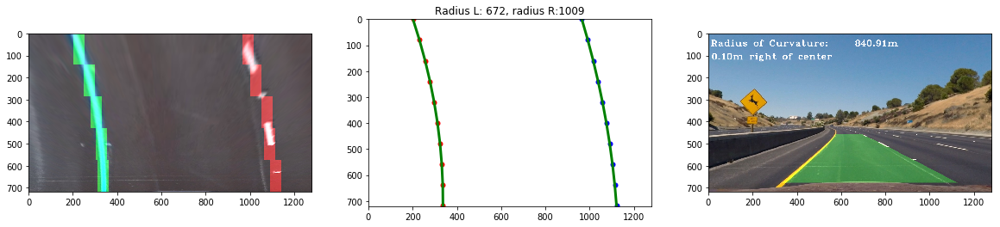

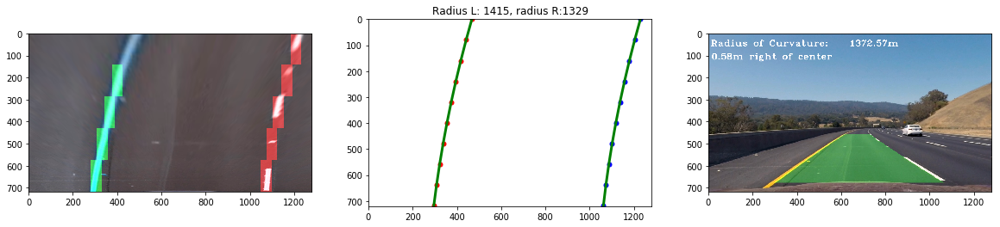

...

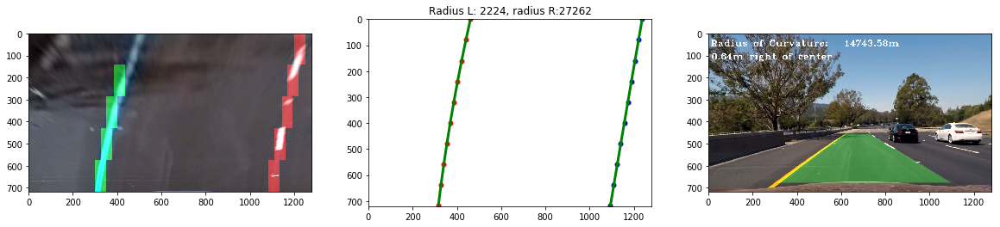

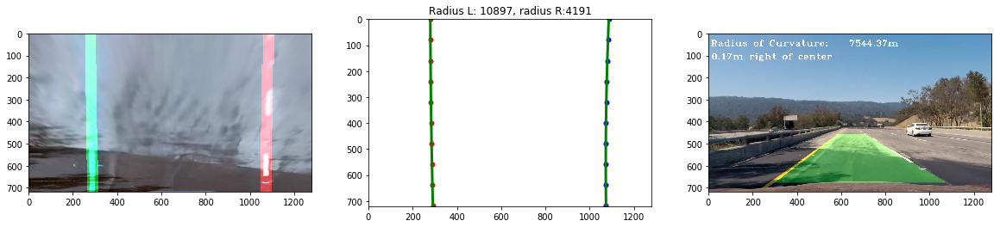

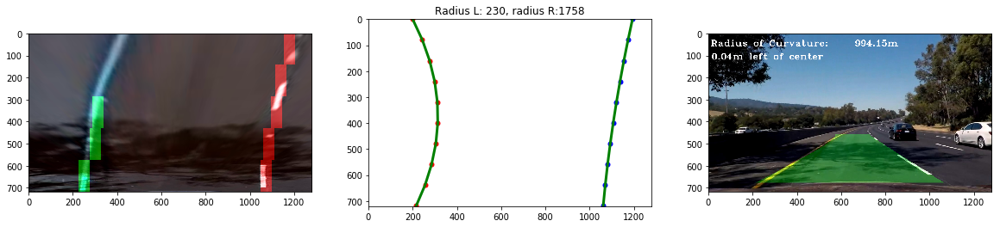

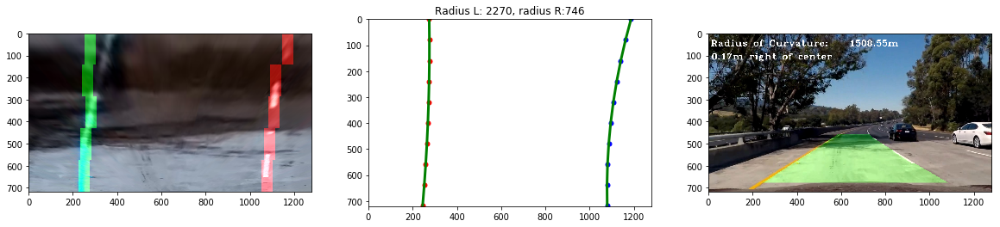

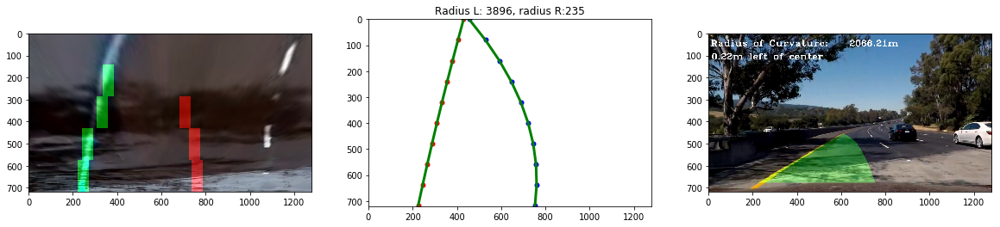

In [50]:
import numpy as np
import matplotlib.pyplot as plt

images = glob.glob('test_images/*.jpg')
left_line = Line()
right_line = Line()
       

ploty=np.array(slices)
for fname in images:
    resetDetectedLines()   # the frames are not sequential so I have to flush the recent updates buffer
    frame = cv2.imread(fname)
    undistorted = undistort(frame)
    image = warper(undistorted,src,dst)
    warped = combined(image,kernelsize)
    window_centroids = find_window_centroids(warped, window_width, window_height, margin)      
    l_centroids = window_centroids[0][0]
    r_centroids = window_centroids[0][1]
    image_height = image.shape[0]
    left_line.update(l_centroids)
    right_line.update(r_centroids)
    
    lx, ly = left_line.getPlotPoints()
    rx, ry = right_line.getPlotPoints()

    mark_size = 5
    fig = plt.figure(figsize=(20, 4))
    fig.add_subplot(1,3,1)
    plt.imshow(drawCentroidsOverlay(warped))
    
    fig.add_subplot(1,3,2)
    plt.plot(lx, ly, 'o', color='red', markersize=mark_size)
    plt.plot(rx,ry, 'o', color='blue', markersize=mark_size)
    plt.title('Radius L: ' + str(int(left_line.radius_of_curvature)) + ', radius R:' + str(int(right_line.radius_of_curvature)))
    plt.xlim(0, 1280)
    plt.ylim(0, 720)
    plt.plot(lx, ly, color='green', linewidth=3)
    plt.plot(rx, ry, color='green', linewidth=3)
    plt.gca().invert_yaxis() # to visualize as we do the images
    
    # process the image
    result = processFrame(frame)
    
    
    
    # Display the image with the overlay
    fig.add_subplot(1,3,3)
    plt.imshow(result[...,::-1])
    plt.show(block=True)

    

In [51]:
# create the project video

resetDetectedLines()
source = VideoFileClip("project_video.mp4")
output = source.fl_image(processFrame) 
%time output.write_videofile('project_video_with_overlay.mp4', audio=False)
source.reader.close()
close_clip(output)

[MoviePy] >>>> Building video project_video_with_overlay.mp4
[MoviePy] Writing video project_video_with_overlay.mp4


100%|█████████████████████████████████████▉| 1260/1261 [14:04<00:00,  1.51it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_with_overlay.mp4 

Wall time: 14min 4s


In [52]:
%%HTML
<video controls width="100%" controls>
  <source src="project_video_with_overlay.mp4" type="video/mp4">
</video>